In [0]:
%python
%pip install folium

  Obtaining dependency information for folium from https://files.pythonhosted.org/packages/81/4d/bcbee0676dc06f0b014a030cb928e158c96daafb872a01ddee7e60a8c998/folium-0.19.5-py2.py3-none-any.whl.metadata
  Obtaining dependency information for branca>=0.6.0 from https://files.pythonhosted.org/packages/f8/9d/91cddd38bd00170aad1a4b198c47b4ed716be45c234e09b835af41f4e717/branca-0.8.1-py3-none-any.whl.metadata
  Obtaining dependency information for xyzservices from https://files.pythonhosted.org/packages/9a/6e/49408735dae940a0c1c225c6b908fd83bd6e3f5fae120f865754e72f78cb/xyzservices-2025.1.0-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/110.9 kB ? eta -:--:--
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.9/110.9 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/88.4 kB ? eta -:--:--
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.4/88.4 kB 6.2 MB/s eta 0:00:00
Note: you may need to restart the kernel using %restart_python or dbutils.library.res

In [0]:
from pyspark.sql.functions import col, sum as spark_sum, count, desc, asc, year,when, isnan, avg, min, max, hour, round
from pyspark.sql.types import DoubleType, FloatType, StringType, IntegerType, DecimalType
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql import functions as F
from pyspark.sql.window import Window
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import folium
from folium.plugins import MarkerCluster
import calendar
import branca.colormap as cm
from folium.plugins import MiniMap
import matplotlib.cm as cm
import pyspark.pandas as ps
from branca.colormap import LinearColormap
from pyspark.sql import SparkSession
from pyspark.ml.feature import StringIndexer, OneHotEncoder, VectorAssembler, StandardScaler
from pyspark.ml import Pipeline
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator, RegressionEvaluator, MulticlassClassificationEvaluator
from pyspark.sql.functions import percent_rank
from pyspark.sql import Window
print("Welcome to the W261 final project!") 

Welcome to the W261 final project!



# Know your mount
Here is the mounting for this class, your source for the original data! Remember, you only have Read access, not Write! Also, become familiar with `dbutils` the equivalent of `gcp` in DataProc

In [0]:
data_BASE_DIR = "dbfs:/mnt/mids-w261/datasets_final_project_2022/"
display(dbutils.fs.ls(f"{data_BASE_DIR}"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/,parquet_airlines_data/,0,1743538703280
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y/,parquet_airlines_data_1y/,0,1743538703280
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_3m/,parquet_airlines_data_3m/,0,1743538703280
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_6m/,parquet_airlines_data_6m/,0,1743538703280
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data/,parquet_weather_data/,0,1743538703280
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_1y/,parquet_weather_data_1y/,0,1743538703281
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_3m/,parquet_weather_data_3m/,0,1743538703281
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_6m/,parquet_weather_data_6m/,0,1743538703281
dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/,stations_data/,0,1743538703281


In [0]:
data_BASE_DIR = "dbfs:/mnt/mids-w261/"
datasets_path = f"{data_BASE_DIR}OTPW_12M/OTPW_12M/"

display(dbutils.fs.ls(datasets_path))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12M/OTPW_12M_2015.csv.gz,OTPW_12M_2015.csv.gz,1227614690,1740508618000
dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12M/OTPW_12W_2015.csv.gz,OTPW_12W_2015.csv.gz,1227614690,1740508618000


In [0]:
df_southwest_12 = spark.read.csv(f"{data_BASE_DIR}OTPW_12M/OTPW_12M/", header=True, inferSchema=True)

In [0]:
print(df_southwest_12.count())

11623708


In [0]:
df_southwest_3 = spark.read.csv(f"{data_BASE_DIR}OTPW_3M/OTPW_3M/", header=True, inferSchema=True)

print(df_southwest_3.count())


#Initial analysis to find the airlines we want to tell our story for - final picked Southwest Airlines

In [0]:
# Airline Data    
df_flights = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_3m/")
display(df_flights)

In [0]:
# Step 1: Total number of rows in the dataset
total_rows = df_flights.count()
print(f"Total rows in dataset: {total_rows}")

# Step 2: Count number of nulls in DEP_DEL15 column
null_count = df_flights.filter(col("DEP_DEL15").isNull()).count()
print(f"Total null values in DEP_DEL15: {null_count}")

# Step 3: Drop null values in DEP_DEL15 column
df_flights_filtered = df_flights.filter(col("DEP_DEL15").isNotNull())

# Step 4: Compute total flights and total delays per airline
df_delays = (
    df_flights_filtered
    .groupBy("OP_UNIQUE_CARRIER")
    .agg(
        count("*").alias("Total_Flights"),  # Count total flights per airline
        sum(col("DEP_DEL15")).alias("Total_Delayed_Flights")  # Count delays
    )
    .withColumn("Delay_Percentage", round((col("Total_Delayed_Flights") / col("Total_Flights")) * 100, 2))  # Calculate delay percentage
    .orderBy(desc("Delay_Percentage"))  # Sort by worst performer
)

# Show the top 10 airlines with the highest delay percentage
display(df_delays.limit(10))

Total rows in dataset: 2806942
Total null values in DEP_DEL15: 84710


OP_UNIQUE_CARRIER,Total_Flights,Total_Delayed_Flights,Delay_Percentage
F9,38692,12054,31.15
MQ,154020,43656,28.34
B6,122284,32138,26.28
UA,231400,59394,25.67
NK,51488,13158,25.56
WN,584382,124438,21.29
AA,250146,50266,20.09
EV,285180,55650,19.51
OO,278348,53046,19.06
VX,27084,4808,17.75


In [0]:
# Airline Data    
df_flights_complete = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/")

In [0]:
# Step 1: Total number of rows in the dataset
total_rows = df_flights_complete.count()
print(f"Total rows in dataset: {total_rows}")

# Step 2: Count number of nulls in DEP_DEL15 column
null_count = df_flights_complete.filter(col("DEP_DEL15").isNull()).count()
print(f"Total null values in DEP_DEL15: {null_count}")

# Step 3: Drop null values in DEP_DEL15 column
df_flights_filtered_complete = df_flights_complete.filter(col("DEP_DEL15").isNotNull())

# Step 4: Compute total flights and total delays per airline
df_delays_complete = (
    df_flights_filtered_complete
    .groupBy("OP_UNIQUE_CARRIER")
    .agg(
        count("*").alias("Total_Flights"),  # Count total flights per airline
        sum(col("DEP_DEL15")).alias("Total_Delayed_Flights")  # Count delays
    )
    .withColumn("Delay_Percentage", round((col("Total_Delayed_Flights") / col("Total_Flights")) * 100, 2))  # Calculate delay percentage
    .orderBy(desc("Delay_Percentage"))  # Sort by worst performer
)

# Show the top 10 airlines with the highest delay percentage
display(df_delays_complete.limit(10))

Total rows in dataset: 74177433
Total null values in DEP_DEL15: 1335235


OP_UNIQUE_CARRIER,Total_Flights,Total_Delayed_Flights,Delay_Percentage
B6,3184956,783600,24.6
F9,1296796,301789,23.27
VX,434172,92484,21.3
WN,14938156,3093934,20.71
G4,596645,123261,20.66
NK,1875597,369164,19.68
UA,6457978,1194443,18.5
EV,3433424,616993,17.97
OH,1498660,267226,17.83
YV,1145547,203103,17.73


In [0]:
# Step 4: Compute total flights and total delays per airline
df_delays_complete = (
    df_flights_filtered_complete
    .groupBy("OP_UNIQUE_CARRIER")
    .agg(
        count("*").alias("Total_Flights"),  # Count total flights per airline
        sum(col("DEP_DEL15")).alias("Total_Delayed_Flights")  # Count delays
    )
    .withColumn("Delay_Percentage", round((col("Total_Delayed_Flights") / col("Total_Flights")) * 100, 2))  # Calculate delay percentage
    .orderBy(asc("Delay_Percentage"))  # Sort by best performer
)

# Show the top 10 airlines with the highest delay percentage
display(df_delays_complete.limit(10))

OP_UNIQUE_CARRIER,Total_Flights,Total_Delayed_Flights,Delay_Percentage
HA,898618,68427,7.61
QX,109633,12805,11.68
AS,2394095,307333,12.84
DL,10580393,1454648,13.75
9E,1446594,204209,14.12
YX,1793211,255968,14.27
US,389650,58288,14.96
OO,8227342,1297799,15.77
MQ,2215456,378277,17.07
AA,9925275,1729128,17.42


In [0]:
# Read Full Airlines Dataset (2015-2021)
df_flights_WN = spark.read.parquet("dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/")

# Filter for Southwest Airlines (WN) only
df_flights_WN = df_flights_WN.filter(col("OP_UNIQUE_CARRIER") == "WN")

# Extract year from flight date
df_flights_WN = df_flights_WN.withColumn("Year", year(col("FL_DATE")))

# Remove rows where DEP_DEL15 is null
df_flights_WN_filtered = df_flights_WN.filter(col("DEP_DEL15").isNotNull())

# Aggregate total flights and total delays per year
df_WN_yearly_delays = (
    df_flights_WN_filtered
    .groupBy("Year")
    .agg(
        count("*").alias("Total_Flights_WN"),
        sum(col("DEP_DEL15")).alias("Total_Delayed_Flights_WN")
    )
    .withColumn("Delay_Percentage_WN", (col("Total_Delayed_Flights_WN") / col("Total_Flights_WN")) * 100)  # Compute percentage
    .orderBy("Year")  # Order by year
)

# Show year-over-year delay statistics
df_WN_yearly_delays.show()

In [0]:
import matplotlib.pyplot as plt
import pandas as pd

# Convert Spark DataFrame to Pandas for visualization
df_WN_pd = df_WN_yearly_delays.toPandas()

# Compute mean delay percentage across all years
mean_delay_percentage = df_WN_pd["Delay_Percentage_UA"].mean()

# Create figure
plt.figure(figsize=(10, 6))

# Plot bar chart
bars = plt.bar(df_WN_pd["Year"], df_WN_pd["Delay_Percentage_UA"], color="skyblue", label="Yearly Delay Percentage")

# Add a horizontal mean line
plt.axhline(y=mean_delay_percentage, color='red', linestyle='--', linewidth=1, label=f"Mean Delay Percentage ({mean_delay_percentage:.2f}%)")

# Add text labels slightly lower for better visibility
for bar in bars:
    yval = bar.get_height()  # Get height of bar (delay percentage)
    plt.text(bar.get_x() + bar.get_width()/2, yval - 1, f"{yval:.2f}%", ha='center', fontsize=10)

# Customize chart
plt.xlabel("Year")
plt.ylabel("Delay Percentage (%)")
plt.title("Southwest Airlines Year-over-Year Flight Delay Trend (2015-2021)")
plt.xticks(df_WN_pd["Year"])  # Ensure all years appear on x-axis
plt.legend()

# **REMOVE the grey dotted lines**
plt.grid(False)  # Disables the grid completely

# **Save the plot as an image**
chart_path = "/dbfs/FileStore/WN_flight_delays_1.png"  # Path in DBFS
plt.savefig(chart_path, dpi=300, bbox_inches='tight')  # High-quality PNG file

# Show plot
plt.show()

# Print path for reference
print(f"Chart saved at: {chart_path}")

In [0]:
# Weather data
df_weather = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_3m/")
display(df_weather)

In [0]:
# Stations data      
df_stations = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/")
display(df_stations)


#EDA starts for the selected cols and airline

In [0]:
# Code by Louis 

df_flights = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y")
df_weather = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_1y/")
df_stations = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/")
df_airport_codes = spark.read.format("csv").option("header","true").load(f"dbfs:/mnt/mids-w261/airport-codes_csv.csv")

df_flights.createOrReplaceTempView("flights")
df_weather.createOrReplaceTempView("weather")
df_stations.createOrReplaceTempView("stations")
df_airport_codes.createOrReplaceTempView("airport_codes")

df_joined = spark.sql("""
    WITH ac AS (
        SELECT
            iata_code,
            name,
            type,
            CAST(SPLIT_PART(coordinates, ',', 1) AS FLOAT) AS longitude,
            CAST(SPLIT_PART(coordinates, ',', 2) AS FLOAT) AS latitude
        FROM
            airport_codes
        WHERE
            iata_code IS NOT NULL
    ),
    s AS (
        SELECT
            DISTINCT neighbor_id,
            neighbor_call,
            neighbor_name,
            neighbor_lat,
            neighbor_lon
        FROM
            stations
    ),
    distances AS (
        SELECT
            ac.iata_code,
            ac.name,
            ac.type,
            ac.latitude,
            ac.longitude,
            s.neighbor_id,
            s.neighbor_call,
            s.neighbor_name,
            s.neighbor_lat,
            s.neighbor_lon,
            6391 * 2 * ASIN(SQRT(POWER(SIN(RADIANS(s.neighbor_lat - ac.latitude) / 2), 2) + COS(RADIANS(ac.latitude)) * COS(RADIANS(s.neighbor_lat)) * POWER(SIN(RADIANS(s.neighbor_lon - ac.longitude) / 2), 2))) AS distance_km
        FROM
            ac CROSS JOIN s
    ),
    distance_rankings AS (
        SELECT
            *,
            ROW_NUMBER() OVER (PARTITION BY iata_code ORDER BY distance_km ASC) AS distance_rank
        FROM
            distances
    ),
    nearest_station AS (
        SELECT
            iata_code,
            name AS airport_name,
            latitude AS airport_lat,
            longitude AS airport_lon,
            type,
            neighbor_id,
            neighbor_name,
            distance_km
        FROM
            distance_rankings
        WHERE
            distance_rank = 1
        ORDER BY
            distance_km ASC
    ),
    state_time_zones AS (
        SELECT 
            state, 
            time_zone_offset
        FROM 
            (
                VALUES
                    ('AL', 'America/Chicago'), 
                    ('AK', 'America/Anchorage'), 
                    ('AZ', 'America/Phoenix'), 
                    ('AR', 'America/Chicago'), 
                    ('CA', 'America/Los_Angeles'), 
                    ('CO', 'America/Denver'), 
                    ('CT', 'America/New_York'), 
                    ('DE', 'America/New_York'), 
                    ('FL', 'America/New_York'), 
                    ('GA', 'America/New_York'), 
                    ('HI', 'Pacific/Honolulu'), 
                    ('ID', 'America/Boise'), 
                    ('IL', 'America/Chicago'), 
                    ('IN', 'America/New_York'), 
                    ('IA', 'America/Chicago'), 
                    ('KS', 'America/Chicago'), 
                    ('KY', 'America/New_York'), 
                    ('LA', 'America/Chicago'), 
                    ('ME', 'America/New_York'), 
                    ('MD', 'America/New_York'), 
                    ('MA', 'America/New_York'), 
                    ('MI', 'America/New_York'), 
                    ('MN', 'America/Chicago'), 
                    ('MS', 'America/Chicago'), 
                    ('MO', 'America/Chicago'), 
                    ('MT', 'America/Denver'), 
                    ('NE', 'America/Chicago'), 
                    ('NV', 'America/Los_Angeles'), 
                    ('NH', 'America/New_York'), 
                    ('NJ', 'America/New_York'), 
                    ('NM', 'America/Denver'), 
                    ('NY', 'America/New_York'), 
                    ('NC', 'America/New_York'), 
                    ('ND', 'America/Chicago'), 
                    ('OH', 'America/New_York'), 
                    ('OK', 'America/Chicago'), 
                    ('OR', 'America/Los_Angeles'), 
                    ('PA', 'America/New_York'), 
                    ('RI', 'America/New_York'), 
                    ('SC', 'America/New_York'), 
                    ('SD', 'America/Chicago'), 
                    ('TN', 'America/Chicago'), 
                    ('TX', 'America/Chicago'), 
                    ('UT', 'America/Denver'), 
                    ('VT', 'America/New_York'), 
                    ('VA', 'America/New_York'), 
                    ('WA', 'America/Los_Angeles'), 
                    ('WV', 'America/New_York'), 
                    ('WI', 'America/Chicago'), 
                    ('WY', 'America/Denver')
            ) AS t(state, time_zone_offset)
    ),
    w AS (
        SELECT
            *,
            TIMESTAMP(
                make_timestamp(
                    CAST(SUBSTR(DATE, 1, 4) AS INT),
                    CAST(SUBSTR(DATE, 6, 2) AS INT),
                    CAST(SUBSTR(DATE, 9, 2) AS INT),
                    CAST(SUBSTR(DATE, 12, 2) AS INT),
                    CAST(SUBSTR(DATE, 15, 2) AS INT),
                    CAST(SUBSTR(DATE, 18, 2) AS INT)
                )
            ) AS weather_date
        FROM
            weather
    ),
    fs AS (
        SELECT
            f.*,
            TO_TIMESTAMP(
                CONCAT(
                    FL_DATE,
                    ' ', 
                    CASE 
                        WHEN LENGTH(CRS_DEP_TIME) = 3 THEN CONCAT('0', SUBSTR(CRS_DEP_TIME, 1, 1), ':', SUBSTR(CRS_DEP_TIME, 2, 2))
                        ELSE CONCAT(SUBSTR(CRS_DEP_TIME, 1, 2), ':', SUBSTR(CRS_DEP_TIME, 3, 2))
                    END,
                    ':00'
                ),
                'yyyy-MM-dd HH:mm:ss'
            ) AS sched_depart_date_time,
            to_utc_timestamp(sched_depart_date_time, st.time_zone_offset) AS sched_depart_date_time_UTC,
            sched_depart_date_time_UTC - INTERVAL 4 HOUR AS four_hours_prior_depart_UTC,
            sched_depart_date_time_UTC - INTERVAL 2 HOUR AS two_hours_prior_depart_UTC,
            n1.airport_name AS origin_airport_name,
            n1.type AS origin_type,
            n1.airport_lat AS origin_airport_lat,
            n1.airport_lon AS origin_airport_lon,
            n1.neighbor_id AS origin_station_id,
            n1.neighbor_name AS origin_station_name,
            n1.distance_km AS origin_dis,
            n2.airport_name AS dest_airport_name,
            n2.type AS dest_type,
            n2.airport_lat AS dest_airport_lat,
            n2.airport_lon AS dest_airport_lon,
            n2.neighbor_id AS dest_station_id,
            n2.neighbor_name AS dest_station_name,
            n2.distance_km AS dest_dis
        FROM
            flights f
            INNER JOIN state_time_zones st ON f.ORIGIN_STATE_ABR = st.state
            INNER JOIN nearest_station n1 ON f.ORIGIN = n1.iata_code
            INNER JOIN nearest_station n2 ON f.DEST = n2.iata_code
        WHERE
            n1.distance_km < 100
            AND n2.distance_km < 100
    )
    SELECT
        *
    FROM
        fs
        INNER JOIN w ON w.weather_date BETWEEN fs.four_hours_prior_depart_UTC AND fs.two_hours_prior_depart_UTC
""")

display(df_joined)



QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,origin_airport_name,origin_type,origin_airport_lat,origin_airport_lon,origin_station_id,origin_station_name,origin_dis,dest_airport_name,dest_type,dest_airport_lat,dest_airport_lon,dest_station_id,dest_station_name,dest_dis,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDu

In [0]:
# OTPW
# df_otpw = spark.read.format("csv").option("header","true").load(f"dbfs:/mnt/mids-w261/OTPW_3M_2015.csv")
df_otpw = spark.read.csv("dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12M/OTPW_12M_2015.csv.gz", header=True, inferSchema=True)
# display(df_otpw)

In [0]:
# Compute null percentage per column
def calculate_null_percentage(df):
    # Count total rows for reference
    total_rows = df.count()
    
    null_percentage_df = df.select([
        (count(when(col(c).isNull() | (col(c) == ""), c)) / total_rows * 100).alias(c)
        for c in df.columns
    ])
    return null_percentage_df

In [0]:
# ----------------------------- #
# ✅ Check Dataset Shape (Rows & Columns)
# ----------------------------- #
num_rows = df_otpw.count()
num_cols = len(df_otpw.columns)

print(f"✅ Dataset contains {num_rows:,} rows and {num_cols} columns.")

null_percentage_df = calculate_null_percentage(df_otpw)
display(null_percentage_df)

✅ Dataset contains 5,811,854 rows and 216 columns.


In [0]:
# List of selected features
selected_features = [
    "DEP_DEL15", "FL_DATE", "YEAR", "QUARTER", "MONTH", 
    "DAY_OF_WEEK", "DAY_OF_MONTH", "OP_CARRIER", "ORIGIN", "DEST", "ORIGIN_CITY_NAME", "DEST_CITY_NAME", "CRS_DEP_TIME", "CRS_ARR_TIME", "ORIGIN_STATE_ABR", "DEST_STATE_ABR", "origin_type",
    "dest_type", "origin_airport_lat", "origin_airport_lon", "dest_airport_lat", "dest_airport_lon", "DISTANCE", "DISTANCE_GROUP", "CANCELLED", "CANCELLATION_CODE",
    "DIVERTED", "CARRIER_DELAY", "WEATHER_DELAY", "NAS_DELAY", "SECURITY_DELAY", "LATE_AIRCRAFT_DELAY",
    "HourlyDewPointTemperature", "HourlyDryBulbTemperature", "HourlyPrecipitation", "HourlyRelativeHumidity", "HourlySkyConditions", "HourlySeaLevelPressure",
    "HourlyVisibility", "HourlyWindDirection", "HourlyWindSpeed", 
]

# Select only required columns
df_selected = df_otpw.select(*selected_features)

# Filter for Southwest Airlines only
df_southwest = df_selected.filter(col("OP_CARRIER") == "WN")

num_rows = df_southwest.count()
num_cols = len(df_southwest.columns)

print(f"✅ Dataset after filtering contains {num_rows:,} rows and {num_cols} columns.")

✅ Dataset after filtering contains 1,261,536 rows and 41 columns.


In [0]:
summary_stats = df_southwest.describe()
display(summary_stats)

summary,DEP_DEL15,FL_DATE,YEAR,QUARTER,MONTH,DAY_OF_WEEK,DAY_OF_MONTH,OP_CARRIER,ORIGIN,DEST,ORIGIN_CITY_NAME,DEST_CITY_NAME,CRS_DEP_TIME,CRS_ARR_TIME,ORIGIN_STATE_ABR,DEST_STATE_ABR,origin_type,dest_type,origin_airport_lat,origin_airport_lon,dest_airport_lat,dest_airport_lon,DISTANCE,DISTANCE_GROUP,CANCELLED,CANCELLATION_CODE,DIVERTED,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,HourlyPrecipitation,HourlyDryBulbTemperature,HourlyWindSpeed,HourlyWindDirection,HourlyVisibility,HourlySeaLevelPressure,HourlyStationPressure,HourlyDewPointTemperature
count,1359057,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,1401363,43449,1401363,286075,286075,286075,286075,286075,1242335,1396906,1396717,1395292,1397276,1247907,1391739,1396790
mean,0.2040400071520179,null,2015.0,1.0,2.0242884962711303,3.93580606880587,15.539602515550932,null,null,null,null,null,1327.3694809981425,1504.956553726622,null,null,null,null,36.44368525499805,-95.31560166780523,36.42518169810379,-95.28793289105002,806.1154183462814,3.6969700213292342,0.031004814598358882,null,0.002249238776819425,18.28032159398759,3.156347111771389,13.46748929476536,0.062266888053832035,22.653755134143143,0.0024986697910195773,47.39732720280171,8.954836141396958,183.51128579857084,9.007992132813234,30.130006451411248,29.2278870452999,32.178502448844256
stddev,0.4029985138108867,null,1.2994599957920602E-13,9.483353222260234E-17,0.8327766474588566,1.9969099342692929,8.69170694936396,null,null,null,null,null,473.68244072208637,491.818773138305,null,null,null,null,5.951503419397688,17.997102392477228,5.978663914142406,18.111139649351195,594.129914810884,2.3402848150294666,0.1733307171533011,null,0.04737279074713474,46.30342782930502,22.354988562240777,25.759553550175866,1.9538552003921414,41.81283206343039,0.01647529171492041,19.44869023747245,5.716072930240633,116.95458212425186,2.4062120819674777,0.20979996854021973,1.3501513443882147,19.184551033572745
min,0.0,2015-01-01,2015,1,1,1,1,AA,ABE,ABE,"Aberdeen, SD","Aberdeen, SD",1,1,AK,AK,large_airport,large_airport,-14.3,-100.5,-14.3,-100.5,100.0,1,0.0,A,0.0,0.0,0.0,0.0,0.0,0.0,0.00,*,0,000,*,28.63,22.22,*
max,1.0,2015-03-31,2015,1,3,7,9,WN,YUM,YUM,"Yuma, AZ","Yuma, AZ",959,959,WY,WY,small_airport,small_airport,71.3,-99.7,71.3,144.8,999.0,9,1.0,D,1.0,996.0,99.0,99.0,99.0,99.0,T,99,9s,VRB,9.94,31.18,30.96,9


### Basic cleaning of selected data to help with visualization

In [0]:
def convert_column_types(df):
    """
    Function to convert column data types appropriately for the flight delay dataset.
    
    Args:
        df: PySpark DataFrame to convert
        
    Returns:
        PySpark DataFrame with converted column types
    """
    # Define column type mappings
    string_columns = [
        "FL_DATE", "OP_CARRIER", "ORIGIN", "DEST", "ORIGIN_CITY_NAME", 
        "DEST_CITY_NAME", "ORIGIN_STATE_ABR", "DEST_STATE_ABR", "origin_type",
        "dest_type", "CANCELLATION_CODE", "HourlySkyConditions"
    ]
    
    double_columns = [
        "DEP_DEL15", "YEAR", "QUARTER", "MONTH", "DAY_OF_WEEK", "DAY_OF_MONTH",
        "CRS_DEP_TIME", "CRS_ARR_TIME", "origin_airport_lat", "origin_airport_lon", 
        "dest_airport_lat", "dest_airport_lon", "DISTANCE", "DISTANCE_GROUP", 
        "CANCELLED", "DIVERTED", "CARRIER_DELAY", "WEATHER_DELAY", "NAS_DELAY", 
        "SECURITY_DELAY", "LATE_AIRCRAFT_DELAY"
    ]
    
    decimal_columns = [
        "HourlyDewPointTemperature", "HourlyDryBulbTemperature", "HourlyPrecipitation",
        "HourlyRelativeHumidity", "HourlySeaLevelPressure", "HourlyVisibility",
        "HourlyWindDirection", "HourlyWindSpeed"
    ]
    
    # Convert string columns
    for column in string_columns:
        if column in df.columns:
            df = df.withColumn(column, col(column).cast(StringType()))
    
    # Convert double columns
    for column in double_columns:
        if column in df.columns:
            df = df.withColumn(column, col(column).cast(DoubleType()))
    
    # Convert decimal columns (with higher precision for weather data)
    for column in decimal_columns:
        if column in df.columns:
            df = df.withColumn(column, col(column).cast(DecimalType(10, 4)))
    
    return df

In [0]:
def clean_flight_data(df):

    # Handle DEP_DEL15 for cancelled flights - assign value 2 to represent "cancelled"
    df = df.withColumn(
        "DEP_DEL15", 
        F.when(F.col("DEP_DEL15").isNull() & (F.col("CANCELLED") == 1), 2).otherwise(F.col("DEP_DEL15"))
    )

    # Drop rows with missing values in critical columns EXCEPT when the flight is cancelled
    critical_cols = ["FL_DATE", "OP_CARRIER", "ORIGIN", "DEST", "CRS_DEP_TIME", "CRS_ARR_TIME"]
    for col in critical_cols:
        df = df.filter((F.col(col).isNotNull()) | (F.col("CANCELLED") == 1))

    # Extract temporal features from FL_DATE if missing
    df = df.withColumn("YEAR_TEMP", F.year("FL_DATE"))
    df = df.withColumn("QUARTER_TEMP", F.quarter("FL_DATE"))
    df = df.withColumn("MONTH_TEMP", F.month("FL_DATE"))
    df = df.withColumn("DAY_OF_WEEK_TEMP", F.dayofweek("FL_DATE"))
    df = df.withColumn("DAY_OF_MONTH_TEMP", F.dayofmonth("FL_DATE"))

    # Replace missing values with extracted values
    df = df.withColumn("YEAR", F.coalesce(F.col("YEAR"), F.col("YEAR_TEMP")))
    df = df.withColumn("QUARTER", F.coalesce(F.col("QUARTER"), F.col("QUARTER_TEMP")))
    df = df.withColumn("MONTH", F.coalesce(F.col("MONTH"), F.col("MONTH_TEMP")))
    df = df.withColumn("DAY_OF_WEEK", F.coalesce(F.col("DAY_OF_WEEK"), F.col("DAY_OF_WEEK_TEMP")))
    df = df.withColumn("DAY_OF_MONTH", F.coalesce(F.col("DAY_OF_MONTH"), F.col("DAY_OF_MONTH_TEMP")))

    # Drop temporary columns
    df = df.drop("YEAR_TEMP", "QUARTER_TEMP", "MONTH_TEMP", "DAY_OF_WEEK_TEMP", "DAY_OF_MONTH_TEMP")

    # Rolling Mean Imputation for weather metrics with small gaps
    window_spec = Window.partitionBy("ORIGIN").orderBy("FL_DATE").rowsBetween(-5, 5) #ToDo: also add depature time here

    weather_cols_rolling = ["HourlyWindSpeed", "HourlyWindDirection", "HourlyDewPointTemperature", 
                            "HourlyDryBulbTemperature", "HourlyVisibility", "HourlyRelativeHumidity"]

    for col in weather_cols_rolling:
        df = df.withColumn(f"{col}_rolling_mean", F.avg(F.col(col)).over(window_spec))
        df = df.withColumn(col, F.coalesce(F.col(col), F.col(f"{col}_rolling_mean")))
        df = df.drop(f"{col}_rolling_mean")

    # Airport/Month-Specific Median Values for precipitation and sea level pressure
    weather_cols_median = ["HourlyPrecipitation", "HourlySeaLevelPressure"]

    for col in weather_cols_median:
        median_expr = F.expr(f"percentile_approx({col}, 0.5)")
        medians = df.groupBy("ORIGIN", "MONTH").agg(median_expr.alias(f"{col}_median"))
        df = df.join(medians, on=["ORIGIN", "MONTH"], how="left")
        df = df.withColumn(col, F.coalesce(F.col(col), F.col(f"{col}_median")))
        df = df.drop(f"{col}_median")

    # Mode Imputation for HourlySkyConditions
    sky_conditions_mode = df.groupBy("ORIGIN", "MONTH").agg(F.mode("HourlySkyConditions").alias("sky_conditions_mode"))
    df = df.join(sky_conditions_mode, on=["ORIGIN", "MONTH"], how="left")
    df = df.withColumn("HourlySkyConditions", F.coalesce(F.col("HourlySkyConditions"), F.col("sky_conditions_mode")))
    df = df.drop("sky_conditions_mode")

    # Handle categorical columns with 'UNKNOWN' for outliers
    categorical_cols = ["ORIGIN_STATE_ABR", "DEST_STATE_ABR", "origin_type", "dest_type"]
    for col in categorical_cols:
        df = df.withColumn(col, F.when(F.col(col).isNull(), "UNKNOWN").otherwise(F.col(col)))

    # Handle distance and distance group for outliers
    df = df.withColumn("DISTANCE", F.when(F.col("DISTANCE") < 0, None).otherwise(F.col("DISTANCE")))
    df = df.withColumn("DISTANCE_GROUP", F.when(F.col("DISTANCE_GROUP") < 0, None).otherwise(F.col("DISTANCE_GROUP")))

    # Impute missing values for distance and distance group with median
    distance_median = df.select(F.expr("percentile_approx(DISTANCE, 0.5)").alias("distance_median")).first()["distance_median"]
    distance_group_median = df.select(F.expr("percentile_approx(DISTANCE_GROUP, 0.5)").alias("dg_median")).first()["dg_median"]
    df = df.withColumn("DISTANCE", F.coalesce(F.col("DISTANCE"), F.lit(distance_median)))
    df = df.withColumn("DISTANCE_GROUP", F.coalesce(F.col("DISTANCE_GROUP"), F.lit(distance_group_median)))

    # For any remaining nulls in geographic coordinates, use airport-specific values
    for col in ["origin_airport_lat", "origin_airport_lon", "dest_airport_lat", "dest_airport_lon"]:
        airport_col = "ORIGIN" if "origin" in col else "DEST"
        common_values = df.filter(F.col(col).isNotNull()).groupBy(airport_col).agg(F.first(col).alias(f"{col}_common"))
        df = df.join(common_values, on=airport_col, how="left")
        df = df.withColumn(col, F.coalesce(F.col(col), F.col(f"{col}_common")))
        df = df.drop(f"{col}_common")

    # After all imputations, check if any nulls remain in weather columns and use global medians as last resort
    all_weather_cols = weather_cols_rolling + weather_cols_median + ["HourlySkyConditions"]
    for col in all_weather_cols:
        global_median = df.select(F.expr(f"percentile_approx({col}, 0.5)").alias("global_median")).first()["global_median"]
        df = df.withColumn(col, F.coalesce(F.col(col), F.lit(global_median)))

    return df

In [0]:
df_southwest_type_conversion = convert_column_types(df_southwest)

In [0]:
df_southwest_cleaned = clean_flight_data(df_southwest_type_conversion)

In [0]:
# Analyze missing values in cleaned features
null_percentage_df = calculate_null_percentage(df_southwest_cleaned)
display(null_percentage_df)

DEST,ORIGIN,MONTH,DEP_DEL15,FL_DATE,YEAR,QUARTER,DAY_OF_WEEK,DAY_OF_MONTH,OP_CARRIER,ORIGIN_CITY_NAME,DEST_CITY_NAME,CRS_DEP_TIME,CRS_ARR_TIME,ORIGIN_STATE_ABR,DEST_STATE_ABR,origin_type,dest_type,origin_airport_lat,origin_airport_lon,dest_airport_lat,dest_airport_lon,DISTANCE,DISTANCE_GROUP,CANCELLED,CANCELLATION_CODE,DIVERTED,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyVisibility,HourlyWindDirection,HourlyWindSpeed
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,98.72837556756208,0.0,81.24651218831647,81.24651218831647,81.24651218831647,81.24651218831647,81.24651218831647,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [0]:
display(df_southwest_cleaned)

DEST,ORIGIN,MONTH,DEP_DEL15,FL_DATE,YEAR,QUARTER,DAY_OF_WEEK,DAY_OF_MONTH,OP_CARRIER,ORIGIN_CITY_NAME,DEST_CITY_NAME,CRS_DEP_TIME,CRS_ARR_TIME,ORIGIN_STATE_ABR,DEST_STATE_ABR,origin_type,dest_type,origin_airport_lat,origin_airport_lon,dest_airport_lat,dest_airport_lon,DISTANCE,DISTANCE_GROUP,CANCELLED,CANCELLATION_CODE,DIVERTED,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,HourlyPrecipitation,HourlyDryBulbTemperature,HourlyWindSpeed,HourlyWindDirection,HourlyVisibility,HourlySeaLevelPressure,HourlyStationPressure,HourlyDewPointTemperature
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1205,1315,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,53,6,200,10.00,30.09,29.31,35
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",2115,2225,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,37,5,230,10.00,30.11,29.33,29
OAK,BUR,1,1.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1555,1705,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,6.0,0.0,0.0,0.0,13.0,0.00,43,0,000,10.00,30.11,29.33,33
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1000,1110,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,57,5,VRB,10.00,30.06,29.29,22
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1320,1430,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,51,0,000,10.00,30.11,29.33,35
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1750,1900,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,41,0,000,10.00,30.11,29.33,32
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",915,1025,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,57,0,000,10.00,30.06,29.29,22
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1655,1805,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,41,0,000,10.00,30.11,29.33,32
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1435,1545,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.00,48,0,000,10.00,30.11,29.33,35
OAK,BUR,1,0.0,2015-01-01,2015,1,4,1,WN,"Burbank, CA","Oakland, CA",1955,2105,CA,CA,medium_airport,large_airport,34.2,-118.4,37.7,-122.2,325.0,2,0.0,null,0.0,null,null,null,null,null,0.0,46.8,2.0,106.0,10.0,30.07,29.313,30.7


# Basic Graphs - we try to find patterns to report back in the Southwest storyline

Below is a high level of what the plots are trying to achieve - 
After getting data only for southwest, we start with the following analysis

1. We show first among the total flights for the timeperiod how many were ontime, delayed and cancelled. from this we will put forth the proposal that since we have so little cancelled flights we wont be proceeding with not utilising them as part of the analysis and will keep the target as delayed by 15 mins or more.

2. After this we show monthly delay trends, to see if there is any seasonality, apart from that we do the same for hour of the day and day of week to find similar patterns. 
3. After that Heatmap of delays by day of week and hour (using DAY_OF_WEEK, CRS_DEP_TIME, DEP_DEL15), I want to see if something emerges out of it.

4. After this a US map, where we calculate the percentage of delayed flight for each airport served by the airline and colour airports on an intensity scale so that it is immediately visible which airports have the max delay, also marked the airports legend based on the orign_type ( this shows whether it is a big, medium or small airport) 

5. Then for top 10 airports with the max delays, we see which routes are the ones suffering the most, 
6. Then we go to delay factors, just a comparison of the different delay reasons and see which one causes the most delays
7. Then correlation between key weather metrics vs delay probability to see which one is the most correlated of them all 
8. Next we see if distance has anything to do with delays, we do a graph between distance group and delays, the index should show the value of the distance group, i.e. what distance range does each group belong to


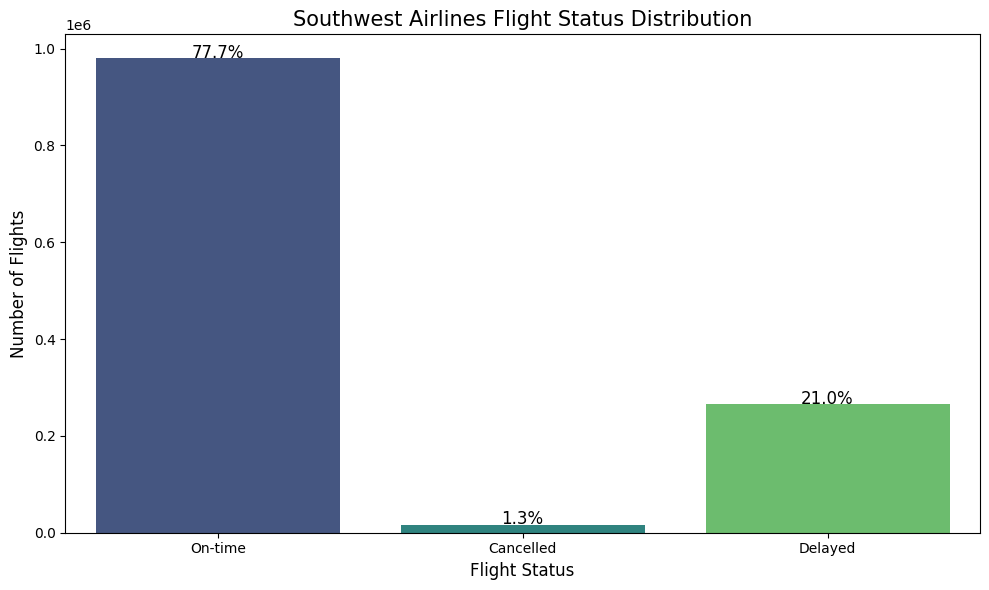

In [0]:
# 1.1 Flight Status Distribution (On-time, Delayed, Cancelled)
# Create a new column for flight status
df_southwest_cleaned = df_southwest_cleaned.withColumn(
    "FLIGHT_STATUS", 
    when(col("CANCELLED") == 1, "Cancelled")
    .when(col("DEP_DEL15") == 1, "Delayed")
    .otherwise("On-time")
)

# Convert to pandas for visualization
flight_status_counts = df_southwest_cleaned.groupBy("FLIGHT_STATUS").count().toPandas()
flight_status_counts['percentage'] = flight_status_counts['count'] / flight_status_counts['count'].sum() * 100

# Plot flight status distribution
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='FLIGHT_STATUS', y='count', data=flight_status_counts, palette='viridis')
plt.title('Southwest Airlines Flight Status Distribution', fontsize=15)
plt.xlabel('Flight Status', fontsize=12)
plt.ylabel('Number of Flights', fontsize=12)

# Add percentage labels on top of bars
for i, row in enumerate(flight_status_counts.itertuples()):
    ax.text(i, row.count + 1000, f'{row.percentage:.1f}%', ha='center', fontsize=12)

plt.tight_layout()
plt.show()

In [0]:
#Todo: Cancelled flight by year of the month

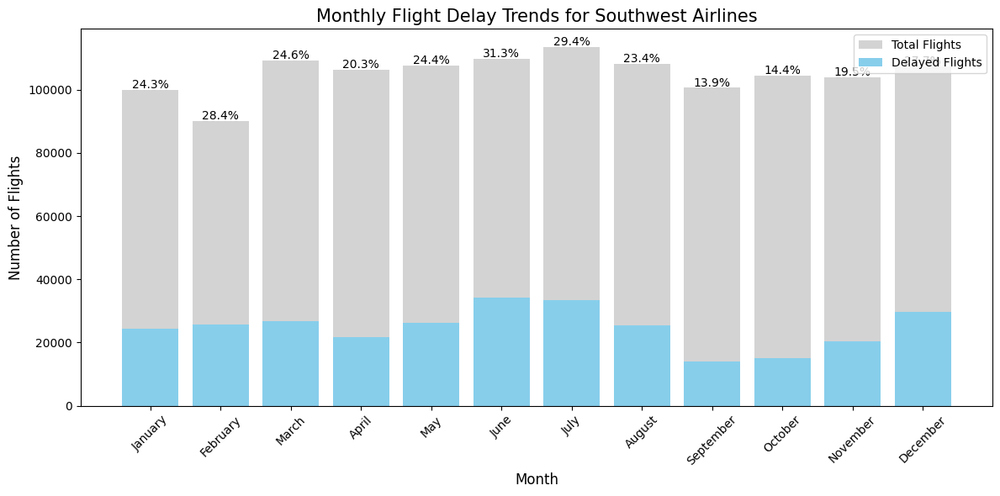

In [0]:
# 2.1 Monthly Delay Trends
monthly_delays = df_southwest_cleaned.groupBy("MONTH").agg(
    avg(col("DEP_DEL15") * 100).alias("delay_percentage"),
    count("*").alias("total_flights")
).orderBy("MONTH").toPandas()

# Convert 'MONTH' column to integers
monthly_delays['MONTH'] = monthly_delays['MONTH'].astype(int)

# Apply calendar.month_name function
monthly_delays['month_name'] = monthly_delays['MONTH'].apply(lambda x: calendar.month_name[x])

# Create a stacked bar chart
plt.figure(figsize=(12, 6))
bars = plt.bar(monthly_delays['month_name'], monthly_delays['total_flights'], color='lightgray', label='Total Flights')
plt.bar(monthly_delays['month_name'], 
        monthly_delays['delay_percentage'] / 100 * monthly_delays['total_flights'], 
        color='skyblue', label='Delayed Flights')

# Annotate delay percentages on bars
for i, row in monthly_delays.iterrows():
    plt.text(i, row['total_flights'] + 500, f"{row['delay_percentage']:.1f}%", ha='center', fontsize=10)

# Add labels and title
plt.title('Monthly Flight Delay Trends for Southwest Airlines', fontsize=15)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Number of Flights', fontsize=12)
plt.legend(loc='upper right')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

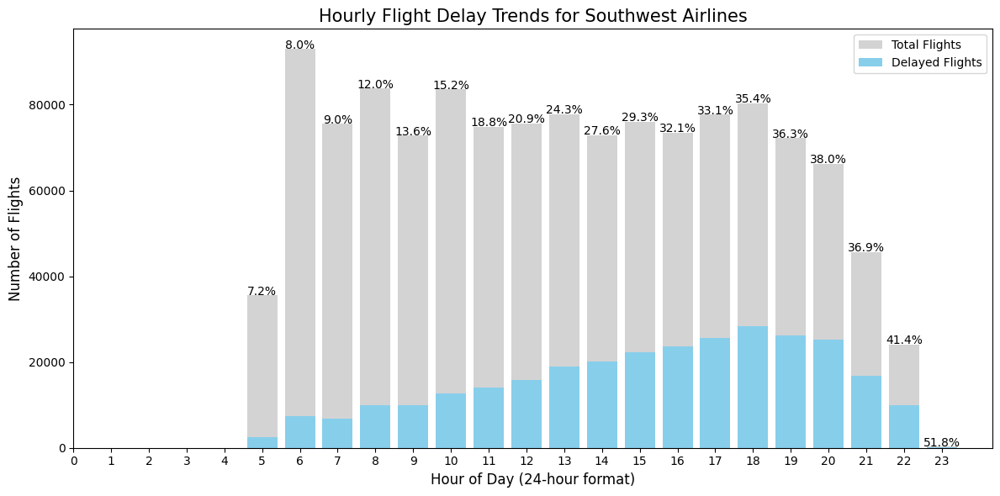

In [0]:
# 2.2 Hour of Day Delay Trends
df_southwest_cleaned = df_southwest_cleaned.withColumn("HOUR_OF_DAY", (col("CRS_DEP_TIME") / 100).cast("int"))

hourly_delays = df_southwest_cleaned.groupBy("HOUR_OF_DAY").agg(
    avg(col("DEP_DEL15") * 100).alias("delay_percentage"),
    count("*").alias("total_flights")
).orderBy("HOUR_OF_DAY").toPandas()

plt.figure(figsize=(12, 6))

# Stacked bar chart for hourly trends
bars = plt.bar(hourly_delays['HOUR_OF_DAY'], hourly_delays['total_flights'], color='lightgray', label='Total Flights')
plt.bar(hourly_delays['HOUR_OF_DAY'], 
        hourly_delays['delay_percentage'] / 100 * hourly_delays['total_flights'], 
        color='skyblue', label='Delayed Flights')

# Annotate delay percentages on bars
for i, row in hourly_delays.iterrows():
    plt.text(row['HOUR_OF_DAY'], row['total_flights'] + 100, f"{row['delay_percentage']:.1f}%", ha='center', fontsize=10)

# Add labels and title
plt.title('Hourly Flight Delay Trends for Southwest Airlines', fontsize=15)
plt.xlabel('Hour of Day (24-hour format)', fontsize=12)
plt.ylabel('Number of Flights', fontsize=12)
plt.legend(loc='upper right')
plt.xticks(range(0, 24))
plt.tight_layout()
plt.show()

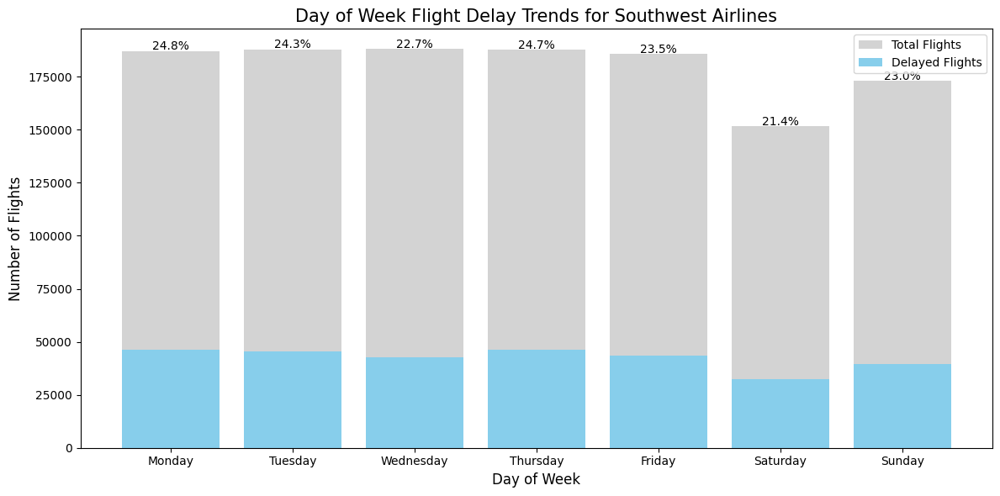

In [0]:
# 2.3 Day of Week Delay Trends
day_of_week_delays = df_southwest_cleaned.groupBy("DAY_OF_WEEK").agg(
    avg(col("DEP_DEL15") * 100).alias("delay_percentage"),
    count("*").alias("total_flights")
).orderBy("DAY_OF_WEEK").toPandas()

# Convert DAY_OF_WEEK to integers
day_of_week_delays['DAY_OF_WEEK'] = day_of_week_delays['DAY_OF_WEEK'].astype(int)

day_of_week_delays['day_name'] = day_of_week_delays['DAY_OF_WEEK'].apply(lambda x: calendar.day_name[x-1])

# Create a stacked bar chart
plt.figure(figsize=(12, 6))
bars = plt.bar(day_of_week_delays['day_name'], day_of_week_delays['total_flights'], color='lightgray', label='Total Flights')
plt.bar(day_of_week_delays['day_name'], 
        day_of_week_delays['delay_percentage'] / 100 * day_of_week_delays['total_flights'], 
        color='skyblue', label='Delayed Flights')

# Annotate delay percentages on bars
for i, row in day_of_week_delays.iterrows():
    plt.text(i, row['total_flights'] + 500, f"{row['delay_percentage']:.1f}%", ha='center', fontsize=10)

# Add labels and title
plt.title('Day of Week Flight Delay Trends for Southwest Airlines', fontsize=15)
plt.xlabel('Day of Week', fontsize=12)
plt.ylabel('Number of Flights', fontsize=12)
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

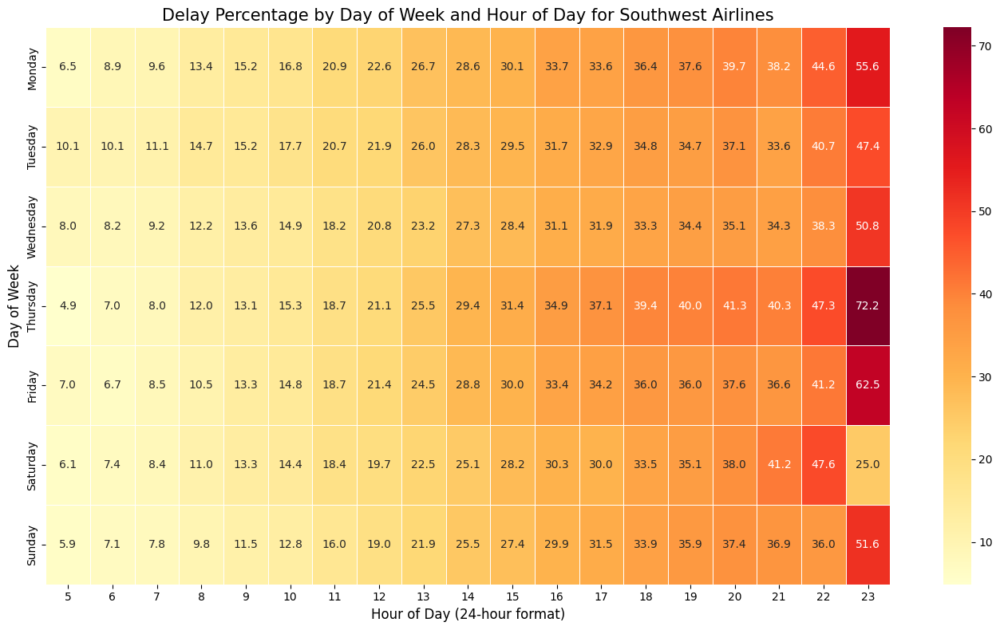

In [0]:
# 3. Heatmap of delays by day of week and hour
day_hour_delays = df_southwest_cleaned.groupBy("DAY_OF_WEEK", "HOUR_OF_DAY").agg(
    avg(col("DEP_DEL15") * 100).alias("delay_percentage")
).toPandas()

# Create a pivot table for the heatmap
heatmap_data = day_hour_delays.pivot(index='DAY_OF_WEEK', columns='HOUR_OF_DAY', values='delay_percentage')

# Map day numbers to day names
day_names = {1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 5: 'Friday', 6: 'Saturday', 7: 'Sunday'}
heatmap_data.index = [day_names[int(day)] for day in heatmap_data.index]

plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data, cmap='YlOrRd', annot=True, fmt='.1f', linewidths=.5)
plt.title('Delay Percentage by Day of Week and Hour of Day for Southwest Airlines', fontsize=15)
plt.xlabel('Hour of Day (24-hour format)', fontsize=12)
plt.ylabel('Day of Week', fontsize=12)
plt.tight_layout()
plt.show()

In [0]:
# Calculate delay percentage for each origin airport
delay_analysis = df_southwest_cleaned.groupby(
    'ORIGIN', 'origin_airport_lat', 'origin_airport_lon', 'origin_type'
).agg(
    (F.mean('DEP_DEL15') * 100).alias('delay_percentage'),
    F.count('DEP_DEL15').alias('total_flights')
).toPandas()

# Create a map centered on the US
us_map = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

# Create a color scale
color_scale = LinearColormap(['#FFCCCC', '#FF0000'], vmin=delay_analysis['delay_percentage'].min(), vmax=delay_analysis['delay_percentage'].max())

# Add the color scale to the map
color_scale.add_to(us_map)

# Add circle markers for each airport (no pins, just circles with color intensity)
for _, row in delay_analysis.iterrows():
    # Determine size based on airport type
    if row['origin_type'] == 'large_airport':
        radius = 8
    elif row['origin_type'] == 'medium_airport':
        radius = 6
    else:  # small_airport
        radius = 4
        
    # Create popup text
    popup_text = f"""
    <b>Airport:</b> {row['ORIGIN']}<br>
    <b>Type:</b> {row['origin_type']}<br>
    <b>Delay %:</b> {row['delay_percentage']:.1f}%<br>
    <b>Total Flights:</b> {row['total_flights']}
    """
    
    # Add circle marker (no pin icon)
    folium.CircleMarker(
        location=[row['origin_airport_lat'], row['origin_airport_lon']],
        radius=radius,
        color='black',
        weight=1,
        fill=True,
        fill_color=color_scale(row['delay_percentage']),
        fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=300)
    ).add_to(us_map)

# Add a legend for the top 10 airports with the most delays
top_10_airports = delay_analysis.sort_values(by='delay_percentage', ascending=False).head(10)

legend_html = '''
<div style="position: fixed; bottom: 50px; right: 50px; width: 300px; height: auto; border:2px solid grey; z-index:9999; font-size:14px; background-color:white; padding: 10px; border-radius: 5px;">
<b>Top 10 Airports with Most Delays</b><br>
'''
for i, row in enumerate(top_10_airports.itertuples(), 1):
    # Add airport type indicator
    airport_type_indicator = "L" if row.origin_type == 'large_airport' else "M" if row.origin_type == 'medium_airport' else "S"
    legend_html += f"{i}. {row.ORIGIN} ({airport_type_indicator}) - {row.delay_percentage:.1f}%<br>"
legend_html += '''
<br><span style="font-size:12px;">Airport Type: L = Large, M = Medium, S = Small</span>
</div>
'''

us_map.get_root().html.add_child(folium.Element(legend_html))

# Save the map
us_map.save('southwest_airport_delays_updated.html')

In [0]:
# Display the map
display(us_map)

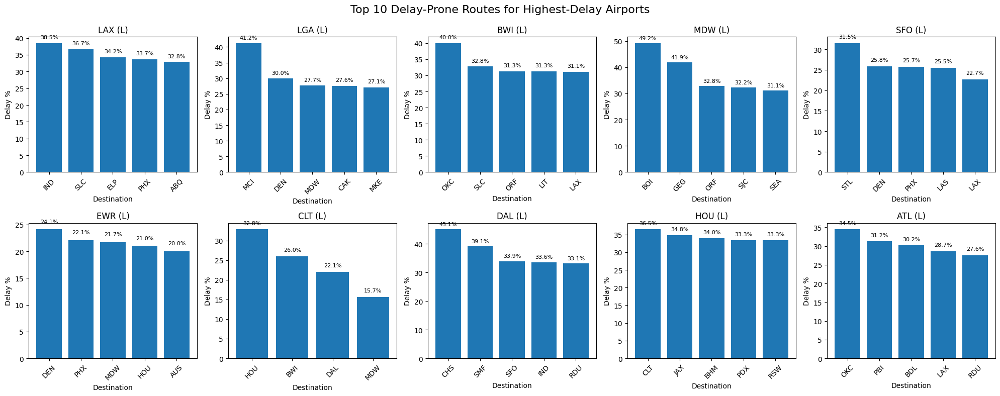

In [0]:
# Create a figure with 10 subplots (two rows of 5 for each airport)
fig, axes = plt.subplots(2, 5, figsize=(20, 8))
axes = axes.flatten()  # Flatten the 2D array to make indexing easier
fig.suptitle('Top 10 Delay-Prone Routes for Highest-Delay Airports', fontsize=16)

# For each top airport, find its most delayed routes
for i, (_, airport) in enumerate(top_10_airports.iterrows()):
    # Filter for flights from this origin
    airport_routes = df_southwest.filter(col("ORIGIN") == airport['ORIGIN'])
    
    # Group by destination and calculate delay percentage
    route_delays = airport_routes.groupBy("DEST").agg(
        (avg(col("DEP_DEL15")) * 100).alias("delay_percentage"),
        count("*").alias("total_flights")
    ).filter(col("total_flights") > 10).orderBy(desc("delay_percentage")).limit(5).toPandas()
    
    # Create small map for this airport's routes
    ax = axes[i]
    ax.set_title(f"{airport['ORIGIN']} ({airport['origin_type'][0].upper()})")
    
    # Plot bar chart of top 5 routes
    bars = ax.bar(route_delays['DEST'], route_delays['delay_percentage'])
    ax.set_ylabel('Delay %')
    ax.set_xlabel('Destination')
    ax.tick_params(axis='x', rotation=45)
    
    # Add value labels on bars
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 1,
                f'{height:.1f}%', ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.subplots_adjust(top=0.90)
plt.show()

# Step 5: Create a map visualization showing the top 10 airports and their routes
us_map = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

# Create a colormap for the routes
colors = cm.rainbow(np.linspace(0, 1, len(top_10_airports)))
airport_colors = {}

# Convert RGB to hex colors for Folium
for i, (_, airport) in enumerate(top_10_airports.iterrows()):
    hex_color = '#{:02x}{:02x}{:02x}'.format(
        int(colors[i][0]*255), 
        int(colors[i][1]*255), 
        int(colors[i][2]*255)
    )
    airport_colors[airport['ORIGIN']] = hex_color

# Add markers for the top 10 airports
for i, (_, airport) in enumerate(top_10_airports.iterrows()):
    # Get color for this airport
    airport_color = airport_colors[airport['ORIGIN']]
    
    # Add marker for the airport
    folium.CircleMarker(
        location=[float(airport['origin_airport_lat']), float(airport['origin_airport_lon'])],
        radius=10,
        color=airport_color,
        fill=True,
        fill_color=airport_color,
        fill_opacity=0.7,
        popup=f"<b>{airport['ORIGIN']}</b><br>Delay %: {airport['delay_percentage']:.1f}%<br>Type: {airport['origin_type']}"
    ).add_to(us_map)
    
    # Get top 5 delayed routes for this airport
    airport_routes = df_southwest_cleaned.filter(col("ORIGIN") == airport['ORIGIN'])
    top_routes = airport_routes.groupBy("DEST", "dest_airport_lat", "dest_airport_lon").agg(
        (avg(col("DEP_DEL15")) * 100).alias("delay_percentage"),
        count("*").alias("total_flights")
    ).filter(col("total_flights") > 10).orderBy(desc("delay_percentage")).limit(5).toPandas()
    
    # Draw lines for each route with the airport's color
    for _, route in top_routes.iterrows():
        folium.PolyLine(
            locations=[
                [float(airport['origin_airport_lat']), float(airport['origin_airport_lon'])],
                [float(route['dest_airport_lat']), float(route['dest_airport_lon'])]
            ],
            color=airport_color,
            weight=2,
            opacity=0.6,
            popup=f"{airport['ORIGIN']} to {route['DEST']}: {route['delay_percentage']:.1f}% delays"
        ).add_to(us_map)
        
        # Add a small marker for the destination
        folium.CircleMarker(
            location=[float(route['dest_airport_lat']), float(route['dest_airport_lon'])],
            radius=4,
            color='green',
            fill=True,
            fill_color='green',
            fill_opacity=0.7,
            popup=f"<b>{route['DEST']}</b>"
        ).add_to(us_map)

# Add a legend for the top 10 airports
legend_html = '''
<div style="position: fixed; bottom: 50px; right: 50px; width: 250px; height: auto; 
    border:2px solid grey; z-index:9999; font-size:14px; background-color:white; 
    padding: 10px; border-radius: 5px;">
<b>Top 10 Airports with Highest Delays</b><br>
'''

for i, (_, airport) in enumerate(top_10_airports.iterrows()):
    airport_type = "L" if airport['origin_type'] == "large_airport" else "M" if airport['origin_type'] == "medium_airport" else "S"
    airport_color = airport_colors[airport['ORIGIN']]
    legend_html += f'<span style="color:{airport_color}">●</span> {i+1}. {airport["ORIGIN"]} ({airport_type}) - {airport["delay_percentage"]:.1f}%<br>'

legend_html += '''
<br><span style="font-size:12px;">Airport Type: L = Large, M = Medium, S = Small</span>
</div>
'''

us_map.get_root().html.add_child(folium.Element(legend_html))

# Save the map
us_map.save('top_10_delayed_airports_routes.html')

In [0]:
display(us_map)

<Figure size 1400x800 with 0 Axes>

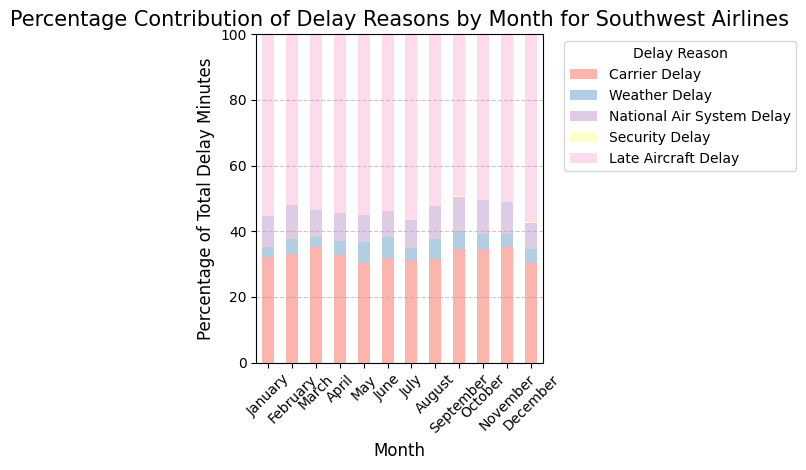

In [0]:
# 6. Delay Factors Comparison by Month
# Filter for delayed flights only
delayed_flights = df_southwest_cleaned.filter(col("DEP_DEL15") == 1)

# Calculate percentage contribution of each delay reason to total delay minutes
delay_reasons_monthly = delayed_flights.groupBy("MONTH").agg(
    (spark_sum(col("CARRIER_DELAY")) / 
     spark_sum(col("CARRIER_DELAY") + col("WEATHER_DELAY") + col("NAS_DELAY") + 
         col("SECURITY_DELAY") + col("LATE_AIRCRAFT_DELAY")) * 100).alias("Carrier Delay"),
    (spark_sum(col("WEATHER_DELAY")) / 
     spark_sum(col("CARRIER_DELAY") + col("WEATHER_DELAY") + col("NAS_DELAY") + 
         col("SECURITY_DELAY") + col("LATE_AIRCRAFT_DELAY")) * 100).alias("Weather Delay"),
    (spark_sum(col("NAS_DELAY")) / 
     spark_sum(col("CARRIER_DELAY") + col("WEATHER_DELAY") + col("NAS_DELAY") + 
         col("SECURITY_DELAY") + col("LATE_AIRCRAFT_DELAY")) * 100).alias("National Air System Delay"),
    (spark_sum(col("SECURITY_DELAY")) / 
     spark_sum(col("CARRIER_DELAY") + col("WEATHER_DELAY") + col("NAS_DELAY") + 
         col("SECURITY_DELAY") + col("LATE_AIRCRAFT_DELAY")) * 100).alias("Security Delay"),
    (spark_sum(col("LATE_AIRCRAFT_DELAY")) / 
     spark_sum(col("CARRIER_DELAY") + col("WEATHER_DELAY") + col("NAS_DELAY") + 
         col("SECURITY_DELAY") + col("LATE_AIRCRAFT_DELAY")) * 100).alias("Late Aircraft Delay"),
    count("*").alias("total_delayed_flights")
).orderBy("MONTH").toPandas()

# Ensure 'MONTH' column is of integer type
delay_reasons_monthly['MONTH'] = delay_reasons_monthly['MONTH'].astype(int)

delay_reasons_monthly['month_name'] = delay_reasons_monthly['MONTH'].apply(lambda x: calendar.month_name[x])

# Create a stacked bar chart with lighter colors
plt.figure(figsize=(14, 8))

# Use a lighter color palette
colors = plt.cm.Pastel1(np.linspace(0, 0.8, 5))  # Pastel colors

delay_reasons_monthly.set_index('month_name')[['Carrier Delay', 'Weather Delay', 'National Air System Delay', 
                                              'Security Delay', 'Late Aircraft Delay']].plot(
    kind='bar', 
    stacked=True,
    color=colors
)

# Add labels and title
plt.title('Percentage Contribution of Delay Reasons by Month for Southwest Airlines', fontsize=15)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Percentage of Total Delay Minutes', fontsize=12)
plt.legend(title='Delay Reason', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Set y-axis to show 0-100%
plt.ylim(0, 100)

plt.tight_layout()
plt.show()

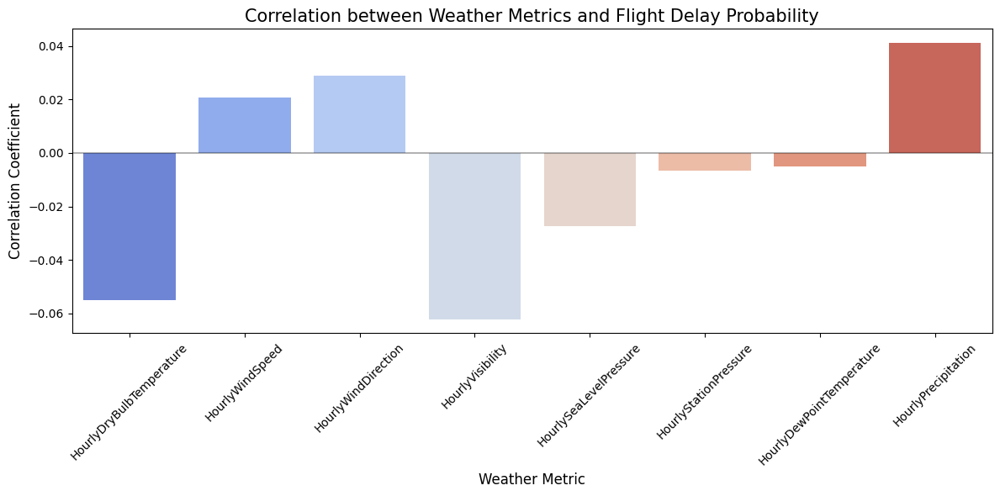

In [0]:
# 7.1 Correlation between Weather Metrics and Delay Probability
weather_columns = [
    'HourlyDryBulbTemperature', 'HourlyWindSpeed', 
    'HourlyWindDirection', 'HourlyVisibility', 
    'HourlySeaLevelPressure', 'HourlyStationPressure', 
    'HourlyDewPointTemperature', 'HourlyPrecipitation'
]

# Convert columns to numeric if they are not already
for col_name in weather_columns + ["DEP_DEL15"]:
    df_southwest_cleaned = df_southwest_cleaned.withColumn(col_name, col(col_name).cast("double"))

# Calculate correlation between each weather metric and delay probability
weather_correlations = []
for col_name in weather_columns:
    correlation = df_southwest_cleaned.stat.corr(col_name, "DEP_DEL15")
    weather_correlations.append({"Weather Metric": col_name, "Correlation with Delay": correlation})

# Convert to Pandas DataFrame for plotting
weather_corr_df = pd.DataFrame(weather_correlations)

# Plotting
plt.figure(figsize=(12, 6))
sns.barplot(x='Weather Metric', y='Correlation with Delay', data=weather_corr_df, palette='coolwarm')
plt.title('Correlation between Weather Metrics and Flight Delay Probability', fontsize=15)
plt.xlabel('Weather Metric', fontsize=12)
plt.ylabel('Correlation Coefficient', fontsize=12)
plt.axhline(y=0, color='black', linestyle='-', alpha=0.3)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

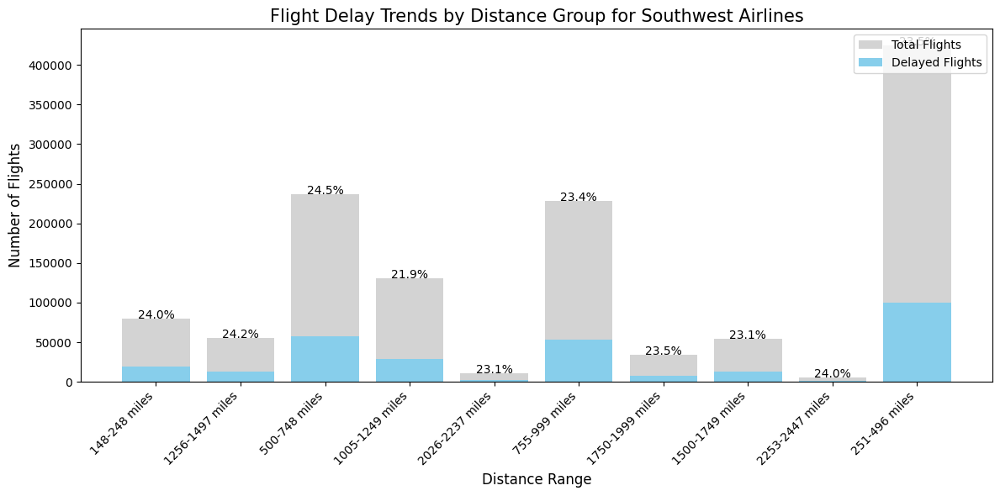

In [0]:
%python
# 8. Distance Group vs Delay Probability
# Calculate the percentage of delayed flights for each distance group
distance_group_analysis = df_southwest_cleaned.groupby('DISTANCE_GROUP').agg(
    (F.mean('DEP_DEL15') * 100).alias('delayed_percentage'),
    F.count('DEP_DEL15').alias('total_flights'),
    F.min('DISTANCE').alias('min_distance'),
    F.max('DISTANCE').alias('max_distance')
).toPandas()

# Add a column for the distance range
distance_group_analysis['distance_range'] = distance_group_analysis.apply(
    lambda row: f"{int(float(row['min_distance']))}-{int(float(row['max_distance']))} miles" if row['max_distance'] != row['min_distance'] else f"{int(float(row['min_distance']))} miles",
    axis=1
)

# Create a stacked bar chart
plt.figure(figsize=(12, 6))

# Bar chart for total flights
bars = plt.bar(distance_group_analysis['distance_range'], 
               distance_group_analysis['total_flights'], 
               color='lightgray', label='Total Flights')

# Bar chart for delayed flights
plt.bar(distance_group_analysis['distance_range'], 
        distance_group_analysis['delayed_percentage'] / 100 * distance_group_analysis['total_flights'], 
        color='skyblue', label='Delayed Flights')

# Annotate delay percentages on bars
for i, row in distance_group_analysis.iterrows():
    plt.text(i, row['total_flights'] + 50, f"{row['delayed_percentage']:.1f}%", ha='center', fontsize=10)

# Add labels and title
plt.title('Flight Delay Trends by Distance Group for Southwest Airlines', fontsize=15)
plt.xlabel('Distance Range', fontsize=12)
plt.ylabel('Number of Flights', fontsize=12)
plt.legend(loc='upper right')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

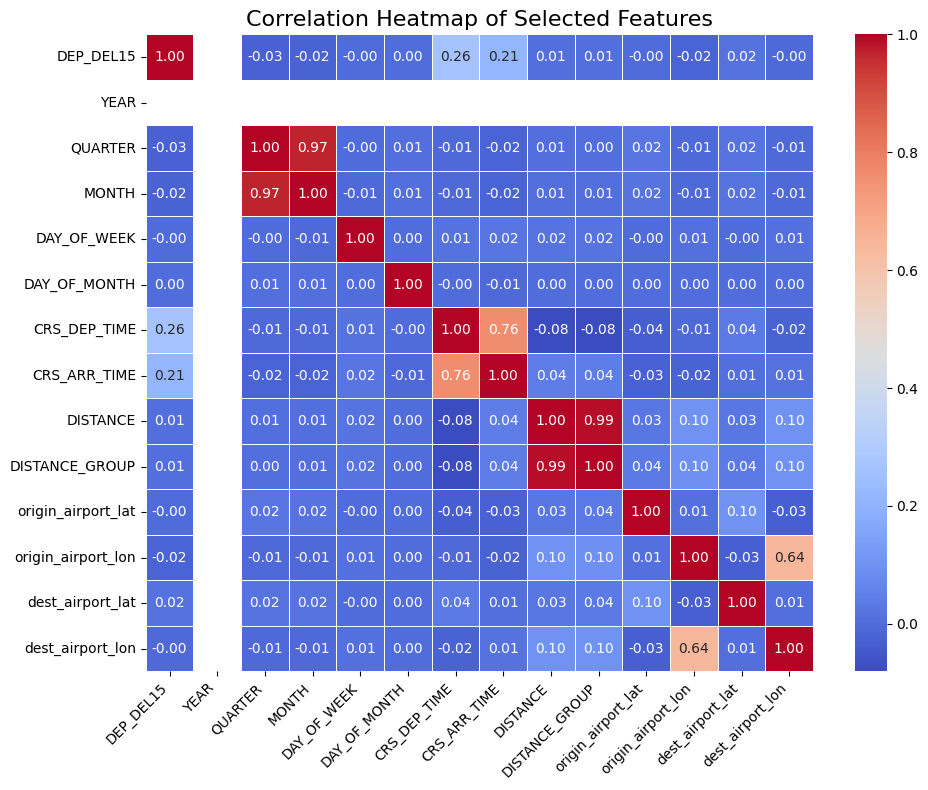

In [0]:
%python
# Load the filtered dataset (with DEP_DEL15 != 2)
df_filtered = df_southwest_cleaned[df_southwest_cleaned['DEP_DEL15'] != 2]

# Convert the Spark DataFrame to a pandas-on-Spark DataFrame
df_filtered_ps = ps.DataFrame(df_filtered)

# Select numerical features for correlation analysis
numerical_features = [
    "DEP_DEL15", "YEAR", "QUARTER", "MONTH", 
    "DAY_OF_WEEK", "DAY_OF_MONTH", "CRS_DEP_TIME", "CRS_ARR_TIME",
    "DISTANCE", "DISTANCE_GROUP", "origin_airport_lat", "origin_airport_lon", 
    "dest_airport_lat", "dest_airport_lon", "HourlyDewPointTemperature", 
    "HourlyDryBulbTemperature", "HourlyPrecipitation", "HourlyVisibility", 
    "HourlySeaLevelPressure", "HourlyWindDirection", "HourlyWindSpeed"
]

# Filter to include only columns that exist in the dataset
numerical_features = [col for col in numerical_features if col in df_filtered_ps.columns]

# Convert to pandas DataFrame
df_filtered_pd = df_filtered_ps.to_pandas()

# Calculate the correlation matrix
correlation_matrix = df_filtered_pd[numerical_features].corr()

# Create correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Heatmap of Selected Features', fontsize=16)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('correlation_heatmap.png')
plt.show()

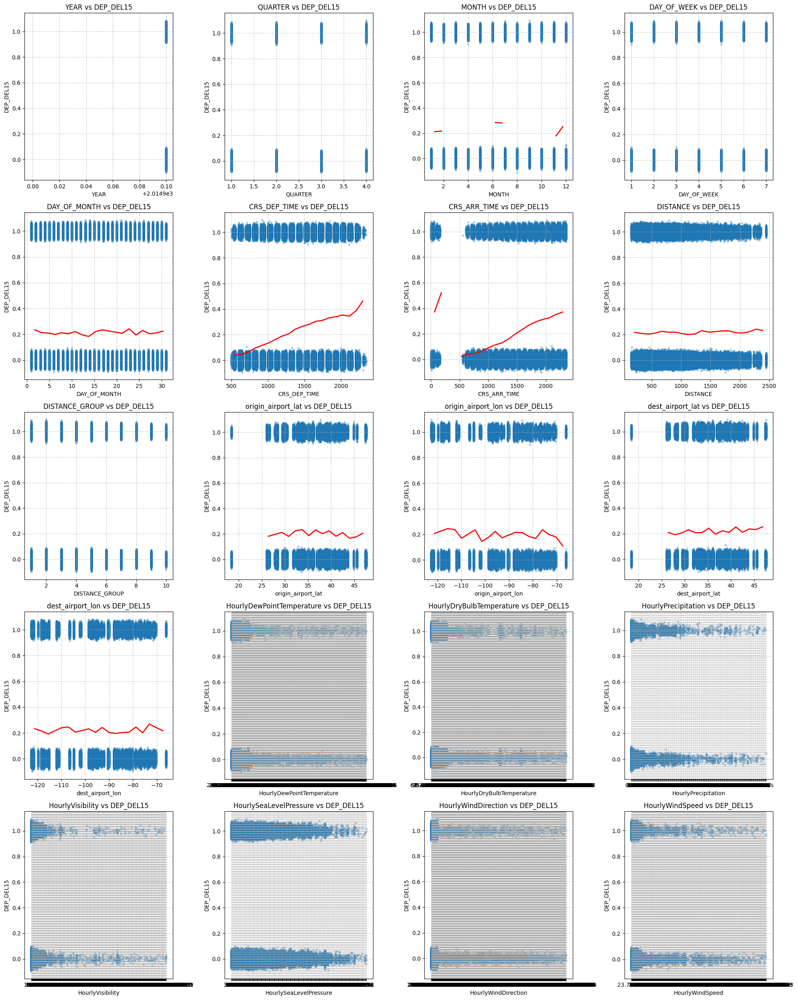

In [0]:
# Create scatter plots for each feature vs DEP_DEL15
features_to_plot = [f for f in numerical_features if f != "DEP_DEL15"]
num_features = len(features_to_plot)
num_cols = 4
num_rows = (num_features + num_cols - 1) // num_cols

plt.figure(figsize=(20, num_rows * 5))

for i, feature in enumerate(features_to_plot):
    plt.subplot(num_rows, num_cols, i+1)
    
    # Add some jitter to the binary target for better visualization
    y = df_filtered_pd['DEP_DEL15'] + np.random.normal(0, 0.02, size=len(df_filtered_pd))
    
    # Create scatter plot
    plt.scatter(df_filtered_pd[feature], y, alpha=0.3, s=10)
    
    # Add a trend line to help visualize patterns
    try:
        # Calculate mean DEP_DEL15 for binned feature values
        bins = pd.cut(df_filtered_pd[feature], 20)
        mean_by_bin = df_filtered_pd.groupby(bins)['DEP_DEL15'].mean()
        bin_centers = [(x.left + x.right)/2 for x in mean_by_bin.index]
        plt.plot(bin_centers, mean_by_bin.values, 'r-', linewidth=2)
    except:
        pass  # Skip trend line if binning fails
    
    plt.title(f'{feature} vs DEP_DEL15', fontsize=12)
    plt.xlabel(feature)
    plt.ylabel('DEP_DEL15')
    plt.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.savefig('scatter_plots_target.png', dpi=300)
plt.show()

In [0]:
# Create folder
# section = "04"
# number = "04"
# folder_path = f"dbfs:/student-groups/Group_{section}_{number}"
# dbutils.fs.mkdirs(folder_path)

folder_path = f"dbfs:/student-groups/Group_04_04"

# Save df_southwest_cleaned as a parquet file
# df_southwest_cleaned.write.parquet(f"{folder_path}/df_otpw_12M_southwest_cleaned_updated.parquet") # use to save a new version
df_southwest_cleaned.write.mode('overwrite').parquet(f"{folder_path}/df_otpw_12M_southwest_cleaned_updated.parquet") # use if you want to overwrite exisiting file

# Read the Processed Data 

In [0]:
data_BASE_DIR = "dbfs:/student-groups/Group_04_04/"
display(dbutils.fs.ls(f"{data_BASE_DIR}"))

path,name,size,modificationTime
dbfs:/student-groups/Group_04_04/df_otpw_12M_southwest_cleaned.parquet/,df_otpw_12M_southwest_cleaned.parquet/,0,1743576740024
dbfs:/student-groups/Group_04_04/df_otpw_12M_southwest_cleaned_updated.parquet/,df_otpw_12M_southwest_cleaned_updated.parquet/,0,1743576740024


In [0]:
df_southwest_cleaned_training = spark.read.parquet(f"dbfs:/student-groups/Group_04_04/df_otpw_12M_southwest_cleaned_updated.parquet/") # always run this because it is in parquet format so subsequent cells will take less time to run

In [0]:
null_percentage_df = calculate_null_percentage(df_southwest_cleaned_training)
display(null_percentage_df)

DEST,ORIGIN,MONTH,DEP_DEL15,FL_DATE,YEAR,QUARTER,DAY_OF_WEEK,DAY_OF_MONTH,OP_CARRIER,ORIGIN_CITY_NAME,DEST_CITY_NAME,CRS_DEP_TIME,CRS_ARR_TIME,ORIGIN_STATE_ABR,DEST_STATE_ABR,origin_type,dest_type,origin_airport_lat,origin_airport_lon,dest_airport_lat,dest_airport_lon,DISTANCE,DISTANCE_GROUP,CANCELLED,CANCELLATION_CODE,DIVERTED,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyVisibility,HourlyWindDirection,HourlyWindSpeed
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,98.72837556756208,0.0,81.24651218831647,81.24651218831647,81.24651218831647,81.24651218831647,81.24651218831647,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Final features for modelling

In [0]:
selected_features_for_training = [
    "DEP_DEL15", "YEAR", "QUARTER", "MONTH", 
    "DAY_OF_WEEK", "DAY_OF_MONTH", "OP_CARRIER", "ORIGIN", "DEST", "CRS_DEP_TIME", "origin_type",
    "dest_type", "origin_airport_lat", "origin_airport_lon", "dest_airport_lat", "dest_airport_lon", "DISTANCE_GROUP",
    "HourlyDewPointTemperature", "HourlyDryBulbTemperature", "HourlyPrecipitation", "HourlyRelativeHumidity", "HourlySkyConditions", "HourlySeaLevelPressure",
    "HourlyVisibility", "HourlyWindDirection", "HourlyWindSpeed"
]

### MLLib pipeline starts

In [0]:
# First, select only the features we need for training
df_southwest_cleaned_training = df_southwest_cleaned_training.select(selected_features_for_training)

# Filter out cancelled flights (DEP_DEL15 = 2)
df_southwest_cleaned_training = df_southwest_cleaned_training.filter(df_southwest_cleaned_training["DEP_DEL15"] != 2)

# Create a Year-Quarter column
df_southwest_cleaned_training = df_southwest_cleaned_training.withColumn("YEAR_QUARTER", 
    F.concat(F.col("YEAR"), F.lit("-Q"), F.col("QUARTER")))

# Extract hour from CRS_DEP_TIME for better feature representation
df_southwest_cleaned_training = df_southwest_cleaned_training.withColumn("DEP_HOUR", 
    (F.col("CRS_DEP_TIME") / 100).cast(IntegerType()))

# Add a weekend variable
df_southwest_cleaned_training = df_southwest_cleaned_training.withColumn("is_weekend", when(df_southwest_cleaned_training.DAY_OF_WEEK.isin(6, 7), 1).otherwise(0))

# Convert string columns to numeric before splitting
columns_to_convert = [
    "HourlyDewPointTemperature", "HourlyDryBulbTemperature", "HourlyPrecipitation",
    "HourlyVisibility", "HourlySeaLevelPressure", "HourlyWindDirection", "HourlyWindSpeed"
]

# Convert columns to double type
# for column in columns_to_convert:
#     df_southwest_cleaned_training = df_southwest_cleaned_training.withColumn(column, col(column).cast(DoubleType()))


# Analyze missing values in cleaned features
null_percentage_df = calculate_null_percentage(df_southwest_cleaned_training)
display(null_percentage_df)

DEP_DEL15,YEAR,QUARTER,MONTH,DAY_OF_WEEK,DAY_OF_MONTH,OP_CARRIER,ORIGIN,DEST,CRS_DEP_TIME,origin_type,dest_type,origin_airport_lat,origin_airport_lon,dest_airport_lat,dest_airport_lon,DISTANCE_GROUP,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyVisibility,HourlyWindDirection,HourlyWindSpeed,YEAR_QUARTER,DEP_HOUR,is_weekend
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [0]:
# Split the dataset
# Test set: Last quarter (Q4)
test_data = df_southwest_cleaned_training.filter(F.col("QUARTER") == 4)

# Validation set: Two months before the test set (October and November)
validation_data = df_southwest_cleaned_training.filter((F.col("MONTH") == 8) | (F.col("MONTH") == 9))

# Train set: All other data
train_data = df_southwest_cleaned_training.filter((F.col("QUARTER") != 4) & (F.col("MONTH") != 8) & (F.col("MONTH") != 9))

print(f"Train data count: {train_data.count()}")
print(f"Validation data count: {validation_data.count()}")
print(f"Test data count: {test_data.count()}")

Train data count: 725367
Validation data count: 207359
Test data count: 313085


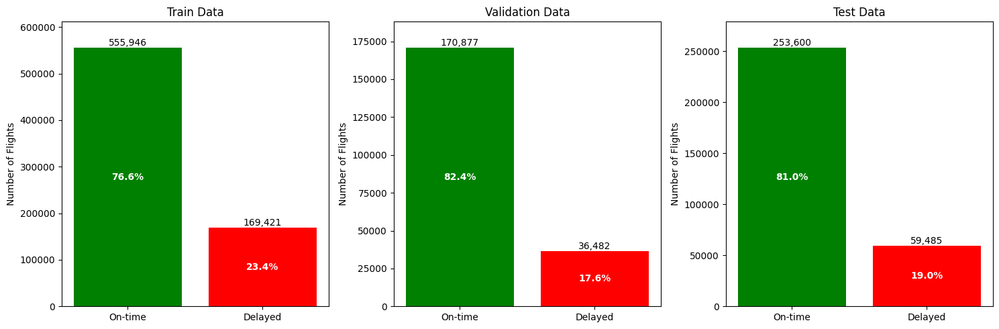

In [0]:
# Visualize delayed vs on-time flights for each dataset
plt.figure(figsize=(15, 5))

# Function to plot delayed vs on-time flights
def plot_delay_distribution(data, position, title):
    delay_counts = data.groupBy("DEP_DEL15").count().toPandas()
    delay_counts = delay_counts.sort_values("DEP_DEL15")
    
    # Calculate percentages
    total = delay_counts["count"].sum()
    delay_counts["percentage"] = delay_counts["count"] / total * 100
    
    # Map 0/1 to meaningful labels
    delay_counts["status"] = delay_counts["DEP_DEL15"].map({0: "On-time", 1: "Delayed"})
    
    # Create subplot
    plt.subplot(1, 3, position)
    bars = plt.bar(delay_counts["status"], delay_counts["count"], color=["green", "red"])
    
    # Add count and percentage labels
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height + 5,
                f'{height:,.0f}', ha='center', va='bottom')
    
    # Add percentage as a second line of text
    for i, p in enumerate(delay_counts["percentage"]):
        plt.text(bars[i].get_x() + bars[i].get_width()/2., bars[i].get_height()/2,
                f'{p:.1f}%', ha='center', va='center', color='white', fontweight='bold')
    
    plt.title(title)
    plt.ylabel("Number of Flights")
    plt.ylim(0, delay_counts["count"].max() * 1.1)

# Plot for each dataset
plot_delay_distribution(train_data, 1, "Train Data")
plot_delay_distribution(validation_data, 2, "Validation Data")
plot_delay_distribution(test_data, 3, "Test Data")

plt.tight_layout()
plt.show()

In [0]:
# Define categorical features with few unique values (for one-hot encoding)
categorical_features_ohe = ["MONTH", "DAY_OF_WEEK", "DAY_OF_MONTH", "DEP_HOUR", "origin_type",
                           "dest_type", "YEAR_QUARTER", "DISTANCE_GROUP", "ORIGIN", "DEST"]

# Define categorical features with many unique values (for indexing only)
categorical_features_idx = ["OP_CARRIER", "ORIGIN", "DEST"]

# Define numerical features for standardization
numerical_features = [
    "origin_airport_lat", "origin_airport_lon", "dest_airport_lat", "dest_airport_lon",
    "HourlyDewPointTemperature", "HourlyDryBulbTemperature", "HourlyPrecipitation",
    "HourlyVisibility", "HourlySeaLevelPressure", "HourlyWindDirection", "HourlyWindSpeed", "is_weekend"
]


# Create stages for the pipeline
stages = []

# Process categorical features with one-hot encoding
for feature in categorical_features_ohe:
    # Create string indexer
    indexer = StringIndexer(inputCol=feature, outputCol=f"{feature}_indexed", handleInvalid="keep")
    # Create one-hot encoder
    encoder = OneHotEncoder(inputCol=f"{feature}_indexed", outputCol=f"{feature}_encoded")
    # Add stages
    stages += [indexer, encoder]

# # Process categorical features with many unique values (just indexing)
# for feature in categorical_features_idx:
#     # Create string indexer
#     indexer = StringIndexer(inputCol=feature, outputCol=f"{feature}_indexed", handleInvalid="keep")
#     # Add stage
#     stages.append(indexer)

# # Handle HourlySkyConditions if it exists in the selected features
# if "HourlySkyConditions" in df_southwest_cleaned_training.columns:
#         # Create string indexer
#     sky_indexer = StringIndexer(inputCol="HourlySkyConditions", outputCol="HourlySkyConditions_indexed", handleInvalid="keep")
#     # Create one-hot encoder
#     sky_encoder = OneHotEncoder(inputCol="HourlySkyConditions_indexed", outputCol="HourlySkyConditions_encoded")
#     # Add stages
#     stages += [sky_indexer, sky_encoder]
#     categorical_features_ohe.append("HourlySkyConditions")

# Collect all transformed features
transformed_features = [f"{feature}_encoded" for feature in categorical_features_ohe] + \
                       numerical_features
# transformed_features = [f"{feature}_encoded" for feature in categorical_features_ohe] + \
#                        [f"{feature}_indexed" for feature in categorical_features_idx] + \
#                        numerical_features

In [0]:
# Create vector assembler
assembler = VectorAssembler(inputCols=transformed_features, outputCol="features_unscaled", handleInvalid="keep")
stages.append(assembler)

# Create standard scaler
scaler = StandardScaler(inputCol="features_unscaled", outputCol="features", withStd=True, withMean=True)
stages.append(scaler)

# Create and fit the pipeline
pipeline = Pipeline(stages=stages)
pipeline_model = pipeline.fit(train_data)

# Transform the datasets
train_data_transformed = pipeline_model.transform(train_data)
validation_data_transformed = pipeline_model.transform(validation_data)
test_data_transformed = pipeline_model.transform(test_data)

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

In [0]:
# Prepare data for modeling
train_data_ml = train_data_transformed.select("DEP_DEL15", "features")
validation_data_ml = validation_data_transformed.select("DEP_DEL15", "features")
test_data_ml = test_data_transformed.select("DEP_DEL15", "features")

# Logistic Regression Model for classification
lr = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=0.1)
lr_model = lr.fit(train_data_ml)

# Evaluate on validation set
lr_predictions = lr_model.transform(validation_data_ml)

# Evaluators for precision, recall, and F1 score
precision_evaluator = MulticlassClassificationEvaluator(labelCol="DEP_DEL15", predictionCol="prediction", metricName="weightedPrecision")
recall_evaluator = MulticlassClassificationEvaluator(labelCol="DEP_DEL15", predictionCol="prediction", metricName="weightedRecall")
f1_evaluator = MulticlassClassificationEvaluator(labelCol="DEP_DEL15", predictionCol="prediction", metricName="f1")

precision = precision_evaluator.evaluate(lr_predictions)
recall = recall_evaluator.evaluate(lr_predictions)
f1_score = f1_evaluator.evaluate(lr_predictions)

print(f"Logistic Regression Precision on validation data: {precision}")
print(f"Logistic Regression Recall on validation data: {recall}")
print(f"Logistic Regression F1 Score on validation data: {f1_score}")

# # Linear Regression Model for regression
# lin_reg = LinearRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=0.1)
# lin_reg_model = lin_reg.fit(train_data_ml)

# # Evaluate on validation set
# lin_reg_predictions = lin_reg_model.transform(validation_data_ml)
# evaluator = RegressionEvaluator(labelCol="DEP_DEL15", metricName="rmse")
# rmse = evaluator.evaluate(lin_reg_predictions)
# print(f"Linear Regression RMSE on validation data: {rmse}")

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Logistic Regression Precision on validation data: 0.7578761354858911
Logistic Regression Recall on validation data: 0.8239574843628682
Logistic Regression F1 Score on validation data: 0.7453712663604554


In [0]:
# Final evaluation on test data
lr_test_predictions = lr_model.transform(test_data_ml)
precision_test = precision_evaluator.evaluate(lr_test_predictions)
recall_test = recall_evaluator.evaluate(lr_test_predictions)
f1_score_test = f1_evaluator.evaluate(lr_test_predictions)

print(f"Logistic Regression Precision on test data: {precision_test}")
print(f"Logistic Regression Recall on test data: {recall_test}")
print(f"Logistic Regression F1 Score on test data: {f1_score_test}")

# # Evaluate linear regression on test data
# lin_reg_test_predictions = lin_reg_model.transform(test_data_ml)
# test_rmse_evaluator = RegressionEvaluator(labelCol="DEP_DEL15", metricName="rmse")
# test_rmse = test_rmse_evaluator.evaluate(lin_reg_test_predictions)
# print(f"Linear Regression RMSE on test data: {test_rmse}")

Logistic Regression Precision on test data: 0.751274259856952
Logistic Regression Recall on test data: 0.8100036731239121
Logistic Regression F1 Score on test data: 0.7256203866223835


In [0]:
# LASSO Regularization

# Logistic Regression Model for classification
lr_lasso = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=0.00001, elasticNetParam=1.0)
lr_model_lasso = lr_lasso.fit(train_data_ml)

# Evaluate on validation set
lr_predictions = lr_model_lasso.transform(validation_data_ml)

precision = precision_evaluator.evaluate(lr_predictions)
recall = recall_evaluator.evaluate(lr_predictions)
f1_score = f1_evaluator.evaluate(lr_predictions)

print(f"Logistic Regression Precision on validation data: {precision}")
print(f"Logistic Regression Recall on validation data: {recall}")
print(f"Logistic Regression F1 Score on validation data: {f1_score}")

# Final evaluation on test data
lr_test_predictions = lr_model_lasso.transform(test_data_ml)
precision_test = precision_evaluator.evaluate(lr_test_predictions)
recall_test = recall_evaluator.evaluate(lr_test_predictions)
f1_score_test = f1_evaluator.evaluate(lr_test_predictions)

print(f"Logistic Regression Precision on test data: {precision_test}")
print(f"Logistic Regression Recall on test data: {recall_test}")
print(f"Logistic Regression F1 Score on test data: {f1_score_test}")

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Logistic Regression Precision on validation data: 0.7519812756255501
Logistic Regression Recall on validation data: 0.8185369335307365
Logistic Regression F1 Score on validation data: 0.7579013719658064
Logistic Regression Precision on test data: 0.7413349540477167
Logistic Regression Recall on test data: 0.8041937493013079
Logistic Regression F1 Score on test data: 0.7446686998977822


In [0]:
# Access the coefficients (weights)
coefficients = lr_model.coefficients
lasso_coefficients = lr_model_lasso.coefficients

for coeff in lasso_coefficients:
    print(coeff)

# # Get the feature names (the input columns of the assembler)
# feature_names = assembler.getInputCols()

# # Combine coefficients and feature names into a DataFrame
# coeff_df = [(feature_names[i], coefficients[i], lasso_coefficients[i]) for i in range(len(lasso_coefficients))]

# # Print the coefficients with feature names
# for feature, coef, lasso_coef in coeff_df:
#     print(f"Feature: {feature}, Coefficient: {coef}, Lasso Coefficient: {lasso_coef}")

0.0769821377012057
0.12913879709852424
-0.015035032347599267
-0.010406876060605474
-0.10565802079071256
-0.06913760976230265
-0.04321558460402002
0.029393766936002864
0.03675310610011899
-0.021065850740654493
-0.024807964149748864
0.01911564923579079
-0.012818150582047945
-0.02358607913099775
-0.00575105794041005
0.008104707970013851
-0.019059045349402007
0.04444519940552042
0.008287859742950932
-0.03899188777750655
0.00944082562879883
0.018140949701285228
0.00664123951046062
0.017779949660657317
0.0050943457011592514
-0.005547181071876701
-0.01705409217451063
-0.00906352878994472
0.003567337072563308
0.0225044588920127
0.010554816829899415
-0.03787434245314712
-0.013150772822618841
-0.015979712150259884
0.041365455723966875
-0.0056544785229557986
0.03210340713029163
-0.006998476764298762
-0.0061618191559176085
0.0
0.005365513570816212
-0.00186010152318166
-0.047526001044664354
0.016231983437244118
-0.009594624140875254
-0.46697387912384175
-0.0997051642590783
-0.21165911159359868
0.19

In [0]:
# No regularization
# LASSO Regularization

# Logistic Regression Model for classification
lr = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=0)
lr_model = lr.fit(train_data_ml)

# Evaluate on validation set
lr_predictions = lr_model.transform(validation_data_ml)

precision = precision_evaluator.evaluate(lr_predictions)
recall = recall_evaluator.evaluate(lr_predictions)
f1_score = f1_evaluator.evaluate(lr_predictions)

print(f"Logistic Regression Precision on validation data: {precision}")
print(f"Logistic Regression Recall on validation data: {recall}")
print(f"Logistic Regression F1 Score on validation data: {f1_score}")

# Final evaluation on test data
lr_test_predictions = lr_model.transform(test_data_ml)
precision_test = precision_evaluator.evaluate(lr_test_predictions)
recall_test = recall_evaluator.evaluate(lr_test_predictions)
f1_score_test = f1_evaluator.evaluate(lr_test_predictions)

print(f"Logistic Regression Precision on test data: {precision_test}")
print(f"Logistic Regression Recall on test data: {recall_test}")
print(f"Logistic Regression F1 Score on test data: {f1_score_test}")

for coeff in lr_model.coefficients:
    print(coeff)

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Logistic Regression Precision on validation data: 0.752662371246328
Logistic Regression Recall on validation data: 0.8189130927521834
Logistic Regression F1 Score on validation data: 0.7578195655728489
Logistic Regression Precision on test data: 0.7417624947124528
Logistic Regression Recall on test data: 0.8034750946228659
Logistic Regression F1 Score on test data: 0.7462139569667399
0.07716497764927994
0.1358629013919978
-0.010314990221434466
-0.0077658364547053965
-0.10183468454193512
-0.05934422816960374
-0.04205650390976023
0.028859934589878202
0.035868656983994066
-0.022292707986105127
-0.02520981363703117
0.01702306269991559
-0.013463469991599107
-0.02413930957903312
-0.006148447366856121
0.007803781620157104
-0.019002229945486226
0.04408105694912877
0.008128458844437273
-0.03918428802329054
0.008640184295589258
0.017580147864693918
0.006749808762851001
0.017962475425895855
0.004652778418432033
-0.006465477772055018
-0.018949747700919242
-0.009308115110338355
0.002342732021719234

# HyperTuning and Cross Validation

In [0]:
train_data_cv_total = train_data_transformed.withColumn("rank", percent_rank().over(Window.partitionBy().orderBy(["YEAR", "MONTH", "DAY_OF_MONTH", "CRS_DEP_TIME"])))
train_data_cv_total.cache()

DataFrame[DEP_DEL15: double, YEAR: double, QUARTER: double, MONTH: double, DAY_OF_WEEK: double, DAY_OF_MONTH: double, OP_CARRIER: string, ORIGIN: string, DEST: string, CRS_DEP_TIME: double, origin_type: string, dest_type: string, origin_airport_lat: double, origin_airport_lon: double, dest_airport_lat: double, dest_airport_lon: double, DISTANCE_GROUP: double, HourlyDewPointTemperature: decimal(14,8), HourlyDryBulbTemperature: decimal(14,8), HourlyPrecipitation: decimal(10,4), HourlyRelativeHumidity: decimal(14,8), HourlySkyConditions: string, HourlySeaLevelPressure: decimal(10,4), HourlyVisibility: decimal(14,8), HourlyWindDirection: decimal(14,8), HourlyWindSpeed: decimal(14,8), YEAR_QUARTER: string, DEP_HOUR: int, is_weekend: int, MONTH_indexed: double, MONTH_encoded: vector, DAY_OF_WEEK_indexed: double, DAY_OF_WEEK_encoded: vector, DAY_OF_MONTH_indexed: double, DAY_OF_MONTH_encoded: vector, DEP_HOUR_indexed: double, DEP_HOUR_encoded: vector, origin_type_indexed: double, origin_type_

In [0]:
# % of train_data_cv_total used as training
training_fold_percent_threshold = [0.2, 0.4, 0.6, 0.8]
regParams = [0.00001, 0.0002, 0.001, 0.01]
precision_cv = np.zeros(len(regParams))
recall_cv = np.zeros(len(regParams))
f1_cv = np.zeros(len(regParams))

In [0]:

# Didn't loop over tfpt for modularity in case of failure
tfpt=training_fold_percent_threshold[0]
train_data_cv = train_data_cv_total.filter(train_data_cv_total.rank <= tfpt)
val_data_cv = train_data_cv_total.filter(train_data_cv_total.rank > tfpt)
train_data_cv = train_data_cv.repartition(200) #Had a oom issue and was recommended to use repartition, but issue still remains. I ultimately restarted the cluster runtime and it works. So perhaps this is not needed
val_data_cv = val_data_cv.repartition(200)
for i, regParam in enumerate(regParams):
  lr_lasso = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=regParam, elasticNetParam=1.0)
  lr_model_lasso = lr_lasso.fit(train_data_cv)
  lr_predictions = lr_model_lasso.transform(val_data_cv)

  lr_precision_cv = precision_evaluator.evaluate(lr_predictions)
  lr_recall_cv = recall_evaluator.evaluate(lr_predictions)
  lr_f1_score_cv = f1_evaluator.evaluate(lr_predictions)
  print(lr_precision_cv)
  print(lr_recall_cv)
  print(lr_f1_score_cv)
  precision_cv[i] += lr_precision_cv
  recall_cv[i] += lr_recall_cv
  f1_cv[i] += lr_f1_score_cv

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6726016894212938
0.755337463487769
0.6618126740572395


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6722486812847838
0.755301274373799
0.6617582694532353


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6728469668284196
0.7562387447547325
0.659484694211943


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.5746396868888406
0.758049923744367
0.653723968958685


In [0]:

# Didn't loop over tfpt for modularity in case of failure
tfpt=training_fold_percent_threshold[1]
train_data_cv = train_data_cv_total.filter(train_data_cv_total.rank <= tfpt)
val_data_cv = train_data_cv_total.filter(train_data_cv_total.rank > tfpt)
train_data_cv = train_data_cv.repartition(200)
val_data_cv = val_data_cv.repartition(200)
for i, regParam in enumerate(regParams):
  lr_lasso = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=regParam, elasticNetParam=1.0)
  lr_model_lasso = lr_lasso.fit(train_data_cv)
  lr_predictions = lr_model_lasso.transform(val_data_cv)

  lr_precision_cv = precision_evaluator.evaluate(lr_predictions)
  lr_recall_cv = recall_evaluator.evaluate(lr_predictions)
  lr_f1_score_cv = f1_evaluator.evaluate(lr_predictions)
  print(lr_precision_cv)
  print(lr_recall_cv)
  print(lr_f1_score_cv)
  precision_cv[i] += lr_precision_cv
  recall_cv[i] += lr_recall_cv
  f1_cv[i] += lr_f1_score_cv

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6731571370169945
0.7514240088232254
0.6528617237502222


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6725411293151613
0.751589444297646
0.651954191092538


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6748197621884074
0.7521776593178083
0.6498875639453073


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.5666495430233972
0.7527612789081258
0.6465792573605789


In [0]:

# Didn't loop over tfpt for modularity in case of failure
tfpt=training_fold_percent_threshold[2]
train_data_cv = train_data_cv_total.filter(train_data_cv_total.rank <= tfpt)
val_data_cv = train_data_cv_total.filter(train_data_cv_total.rank > tfpt)
train_data_cv = train_data_cv.repartition(200)
val_data_cv = val_data_cv.repartition(200)
for i, regParam in enumerate(regParams):
  lr_lasso = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=regParam, elasticNetParam=1.0)
  lr_model_lasso = lr_lasso.fit(train_data_cv)
  lr_predictions = lr_model_lasso.transform(val_data_cv)

  lr_precision_cv = precision_evaluator.evaluate(lr_predictions)
  lr_recall_cv = recall_evaluator.evaluate(lr_predictions)
  lr_f1_score_cv = f1_evaluator.evaluate(lr_predictions)
  print(lr_precision_cv)
  print(lr_recall_cv)
  print(lr_f1_score_cv)
  precision_cv[i] += lr_precision_cv
  recall_cv[i] += lr_recall_cv
  f1_cv[i] += lr_f1_score_cv

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.667205140560287
0.7267478733231307
0.6157503327344371


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6673909115432843
0.7267478733231308
0.6151833004553132


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6740892304221136
0.7268133625622147
0.6135358133667297


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.5280823158270158
0.7266927244902179
0.6116691271551223


In [0]:

# Didn't loop over tfpt for modularity in case of failure
tfpt=training_fold_percent_threshold[3]
train_data_cv = train_data_cv_total.filter(train_data_cv_total.rank <= tfpt)
val_data_cv = train_data_cv_total.filter(train_data_cv_total.rank > tfpt)
train_data_cv = train_data_cv.repartition(200)
val_data_cv = val_data_cv.repartition(200)
for i, regParam in enumerate(regParams):
  lr_lasso = LogisticRegression(featuresCol="features", labelCol="DEP_DEL15", maxIter=10, regParam=regParam, elasticNetParam=1.0)
  lr_model_lasso = lr_lasso.fit(train_data_cv)
  lr_predictions = lr_model_lasso.transform(val_data_cv)

  lr_precision_cv = precision_evaluator.evaluate(lr_predictions)
  lr_recall_cv = recall_evaluator.evaluate(lr_predictions)
  lr_f1_score_cv = f1_evaluator.evaluate(lr_predictions)
  print(lr_precision_cv)
  print(lr_recall_cv)
  print(lr_f1_score_cv)
  precision_cv[i] += lr_precision_cv
  recall_cv[i] += lr_recall_cv
  f1_cv[i] += lr_f1_score_cv

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6688609965078607
0.7145772011939147
0.6131523461501996


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6685410210945136
0.7144738021217489
0.6122907409505267


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.6694284699497325
0.7141842847196851
0.6077856839090208


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

0.5079149939019613
0.7126815515375442
0.5931225141603064


In [0]:
precision_cv = precision_cv / len(training_fold_percent_threshold)
recall_cv = recall_cv / len(training_fold_percent_threshold)
f1_cv = f1_cv / len(training_fold_percent_threshold)
print(precision_cv)
print("Best Precision under Cross Validation is " + str(np.max(precision_cv)) + "at regParam = " + str(regParams[np.argmax(precision_cv)]))
print("Best Recall under Cross Validation is " + str(np.max(recall_cv)) + "at regParam = " + str(regParams[np.argmax(recall_cv)]))
print("Best F1 under Cross Validation is " + str(np.max(f1_cv)) + "at regParam = " + str(regParams[np.argmax(f1_cv)]))

[0.67045624 0.67018044 0.67279611 0.54432163]
Best Precision under Cross Validation is 0.6727961073471682at regParam = 0.001
Best Recall under Cross Validation is 0.7375463696700637at regParam = 0.01
Best F1 under Cross Validation is 0.6358942691730246at regParam = 1e-05
